# Data Exploration

## 1. PagerDuty Incident Data - Load from downloaded files
###   - From Jan 2019 to Nov 2019

####   - Load from files and combined into one CSV file "all.csv"

In [2]:
import pandas as pd
import os
from matplotlib import pyplot as plt
import datetime
%matplotlib notebook

from IPython.display import display, HTML

one_drive_folder = "../Incident Prediction"

pd_data_input = "/pagerduty_Incident_data/incidents/"
pd_data_output ="/pagerduty_Incident_data/generated/"

input_directory = one_drive_folder + pd_data_input
output_directory = one_drive_folder + pd_data_output

incidents = pd.DataFrame(columns=['id', 'incident_number', 'description', 'service_id', 'service_name',
                           'escalation_policy_id','escalation_policy_name','created_on', 'resolved_on'
                           'seconds_to_first_ack','seconds_to_resolve', 'auto_resolved', 
                           'escalation_count', 'auto_escalation_count', 'acknowledge_count',
                           'assignment_count', 'acknowledged_by_user_ids','acknowledged_by_user_names', 
                           'assigned_to_user_ids','resolved_by_user_id','urgency'])

for root,dirs,files in os.walk(input_directory):
    for file in files:
        #print(file)
        temp = pd.read_csv(input_directory + file)
        incidents = incidents.append(temp)
incidents.to_csv(output_directory + "all.csv")
incidents.describe()
#print(len(incidents))

/Users/a071887/pdip/venv/lib/python3.7/site-packages/pandas/core/frame.py:7123: FutureWarning: Sorting because non-concatenation axis is not aligned. A future version
of pandas will change to not sort by default.

To accept the future behavior, pass 'sort=False'.

To retain the current behavior and silence the warning, pass 'sort=True'.

  sort=sort,


,seconds_to_first_ack
count,1.784590e+05
mean,2.342812e+04
std,2.966711e+05
min,0.000000e+00
25%,1.700000e+01
50%,2.900000e+01
75%,8.400000e+01
max,8.169765e+06


## 2. PagerDuty Incident Data - Load from all.csv into a Pandas Dataframe

In [3]:
import pandas as pd
import os
import datetime
from IPython.display import display, HTML
%matplotlib notebook
from matplotlib import pyplot as plt

all = pd.read_csv(output_directory + "all.csv")
compact = all[['created_on','resolved_on','service_name','description','seconds_to_resolve','urgency']].copy()

## 3. PagerDuty Incident Data - Extract date and time from datetime column

In [4]:
compact['created_date'] = [datetime.datetime.date(pd.to_datetime(d,utc=True)) for d in compact['created_on']]
compact['created_time'] = [datetime.datetime.time(pd.to_datetime(d,utc=True)) for d in compact['created_on']]
compact['created_datetime'] = [pd.to_datetime(d,utc=True) for d in compact['created_on']]
compact_datetime = compact

## 4. PagerDuty Incident Data - Filter out rows based on strings contained in Service Name

In [5]:
temp1 = compact_datetime[~compact_datetime.service_name.str.contains("BCOM")]
temp2 = temp1[~temp1.service_name.str.contains("STARS")]
temp3 = temp2[~temp2.service_name.str.contains("DaaS")]
temp4 = temp3[~temp3.service_name.str.contains("EDPOC")]
temp5 = temp4[~temp4.service_name.str.contains("TEST")]
temp6 = temp5[~temp5.service_name.str.contains("perf tasks")]
temp7 = temp6[~temp6.service_name.str.contains("escalation")]
temp8 = temp7[~temp7.service_name.str.contains("prometheus")]
temp9 = temp8[~temp8.service_name.str.contains("stella")]
temp10 = temp9[~temp9.service_name.str.contains("Stackdriver")]
temp11 = temp10[~temp10.service_name.str.contains("Test")]
temp12 = temp11[~temp11.service_name.str.contains("EMLP")]
temp13 = temp12[~temp12.service_name.str.contains("testing")]
temp14 = temp13[~temp13.service_name.str.contains("Demo")]
temp15 = temp14[~temp14.service_name.str.contains("Default")]
temp16 = temp15[~temp15.service_name.str.contains("Escalation")]
temp17 = temp16[~temp16.service_name.str.contains("Escalations")]
filtered_incidents = temp17[~temp17.service_name.str.contains("Perf")]
filtered_pd_incidents = filtered_incidents
#filtered_pd_incidents

servicenames = filtered_pd_incidents.service_name.unique()
#servicenames



## 5. PagerDuty Incident Data - Create scatter chart to plot incidents of each service name   over timeline

<IPython.core.display.Javascript object>


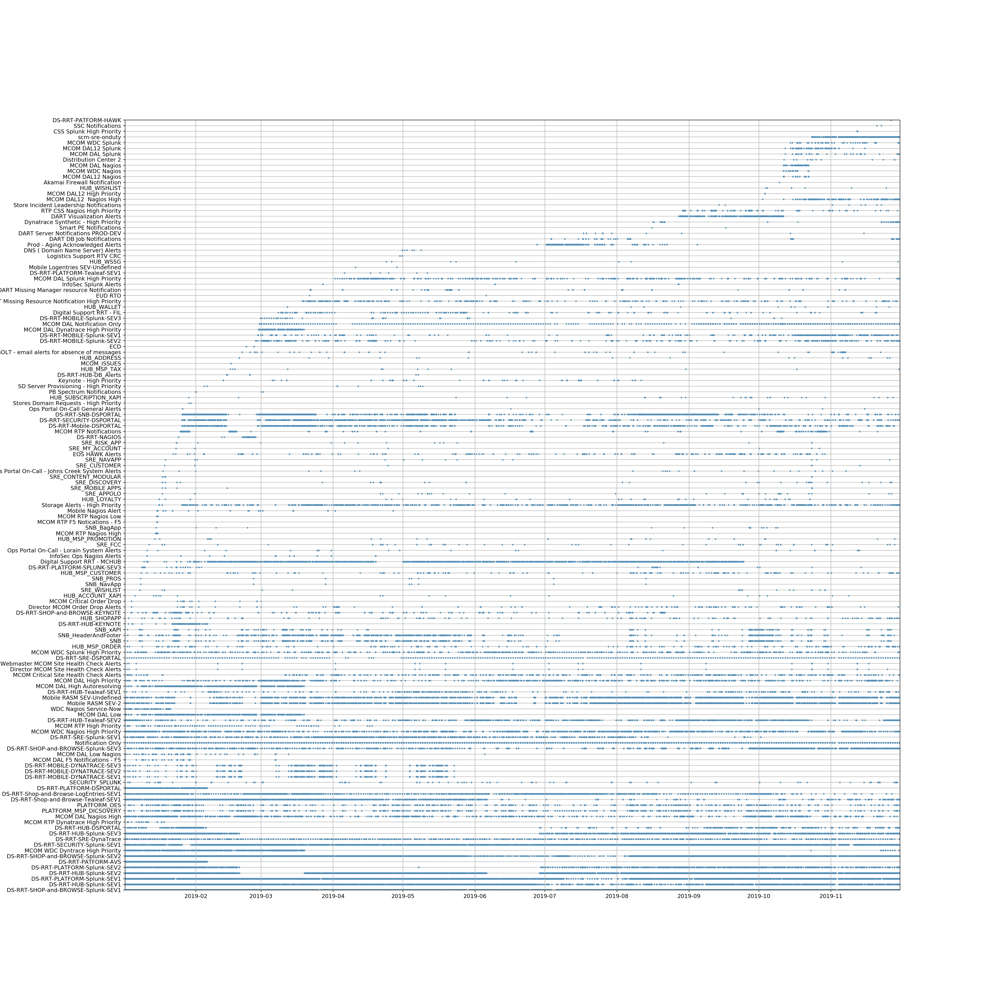

In [401]:
import PyQt5

%matplotlib notebook
startdate = pd.to_datetime("2019-01-01",utc=True).date()
enddate = pd.to_datetime("2019-11-30",utc=True).date()
filtered_pd_incidents.set_index('created_date')
mask = (filtered_pd_incidents['created_date'] >= startdate) & (filtered_pd_incidents['created_date'] <= enddate)
june2019 = filtered_pd_incidents.loc[mask]
fig, ax = plt.subplots(figsize=(25,25))
ax.margins(x=-0.001, y=0)
grouped = june2019.groupby(['created_datetime','created_time','service_name']).count()['description'].reset_index()
pd.set_option('display.max_rows', 5000)
grouped
ax.scatter(grouped['created_datetime'],grouped['service_name'],3)
ax.grid(True)

## 6. JIRA Issues - Load data from csv file exported from JIRA based on following filter condition 

#### project = DS AND created >= startOfYear() AND Brand in (MCOM, "MCOM and BCOM") AND cf[10152] in ("00: Production Emergency", "10: Critical", "20: High") AND "Impacted Functionality" in ("Order Drop/Dip", "Orders to Batch") ORDER BY cf[12932] ASC, cf[10302] ASC, resolution DESC

In [46]:
jira_data_input = "/JIRA/"
input_directory = one_drive_folder + jira_data_input 
all_jira = pd.read_csv(input_directory + "jira_filtered.csv")
all_jira.set_index('Created')
#sev_compact = all_jira[['Created','Summary','Description','Custom field (Brand)','Custom field (Channel)','Custom field (Component)']].copy()
sev_compact = all_jira[['Created','Summary','Description','Custom field (Brand)','Custom field (Channel)','Custom field (Component)', 'Issue key']].copy()
sev_compact['jira_ticket'] = sev_compact['Issue key'].astype(str)
del sev_compact['Issue key']
#sev_compact.dtypes
#sev_compact

,Created,Summary,Description,Custom field (Brand),Custom field (Channel),Custom field (Component),jira_ticket
0,11/27/19 10:15,Andriod Order Dip 12:26 PM EST,!image-2019-11-27-23-44-36-879.png!,MCOM,Mobile Android App,Android,DS-887937
1,11/25/19 20:04,MCOM & BCOM: Order Drop - 11/25,!image-2019-11-25-23-03-48-298.png!,MCOM and BCOM,Desktop,Infrastructure,DS-886275
2,11/13/19 9:50,Paypal orders Drop from 12:28 PM - 12:43 PM 1...,Paypal Orders Drop @ 12:40 11/12,MCOM and BCOM,Desktop,MSP-Order,DS-873827
3,10/23/19 19:58,Order Drop in MCOM/BCOM - WDC 10/23 06.36 PM ...,Order Drop in MCOM/BCOM - WDC 10/23 06.36 PM ...,MCOM and BCOM,Desktop,Akamai,DS-847889
4,10/23/19 2:19,Disable batch mode for 19.17 environments mcom...,The real/online mode is required on mcom-148 a...,MCOM,MobileApp,Unknown -> Unknown,DS-846396
5,10/17/19 7:41,"100% MCOM,BCOM orders going to batch 10/17",OTB from 1:14AM to 1:50 AM EST 10/17.,MCOM and BCOM,Desktop,MSP-Order,DS-830168
6,10/14/19 16:46,OTB from 5:01 PM to 6:11 PM EST on both brands...,INC0743908\r\n\r\nOrders to batch from 5:01 PM...,MCOM and BCOM,Desktop,MSP-Order,DS-829975
7,10/8/19 3:29,MCOM (WDC) Order drop @9:07 PM to 10:14 PM EST,MCOM (WDC) Order drop @9:37 PM to 10:14 PM EST,MCOM,Desktop,ECD,DS-829534
8,9/30/19 21:15,Order drop on MCOM during DAL load test 30/09,Order Dip on MCOM – 10/01,MCOM,Desktop,MSP-Order,DS-828992
9,9/20/19 8:21,Orders to Batch on MCOM and BCOM -- 09/20,h1. Orders to Batch on MCOM and BCOM -- 09/20\...,MCOM and BCOM,Desktop,MSP-Order,DS-824355


## 7. JIRA Issues - Extract date and time from datetime column

In [48]:
sev_compact['created_date'] = [datetime.datetime.date(pd.to_datetime(d,utc=True)) for d in sev_compact['Created']]
sev_compact['created_time'] = [datetime.datetime.time(pd.to_datetime(d,utc=True)) for d in sev_compact['Created']]
sev_compact['created_datetime'] = [pd.to_datetime(d,utc=True) for d in sev_compact['Created']]
sev_compact['service_name'] = ['jira_sev1_issue' for d in sev_compact['Created']]
sev_compact['description'] = [sev_compact['Description'] for d in sev_compact['Description']]
#sev_compact['jira_ticket'] = [sev_compact['Issue key'] for d in sev_compact['Issue key']]
sev_compact.set_index('created_date')
sev_compact_datetime = sev_compact
#sev_compact_datetime

## 7. JIRA Issues - Create scatter chart to plot incidents of each service name over timeline and overlay another chart to plot JIRA issues over the same timeline

#### JIRA issues are plotted with RED dots.

In [404]:
startdate = pd.to_datetime("2019-01-01").date()
enddate = pd.to_datetime("2019-11-30").date()
sev_mask = (sev_compact['created_date'] >= startdate) & (sev_compact['created_date'] <= enddate)
sev_june2019 = sev_compact_datetime.loc[sev_mask]
sev_grouped = sev_june2019.groupby(['created_datetime','created_time','service_name']).count()['description'].reset_index()
sev_plus_grouped = grouped.append(sev_grouped)
#%matplotlib notebook
fig1, ax1 = plt.subplots(figsize=(25,100))
servicenamelist = sev_plus_grouped.service_name.unique()
for servicename in servicenamelist:
    if servicename == 'jira_sev1_issue':
        color = 'red'
        scale = 50
        ax1.margins(x=-0.01, y=0)
        ax1.scatter(sev_grouped['created_datetime'],sev_grouped['service_name'],c=color,s=scale)
    else:
        color = 'blue'
        scale = 3
        ax1.margins(x=-0.01, y=0)
        ax1.scatter(grouped['created_datetime'],grouped['service_name'],c=color,s=scale)

ax1.grid(True)

<IPython.core.display.Javascript object>

## 8. JIRA Issues - Further filter out on component contains "MSP-Order" and Summary contains "Orders To Batch"

In [50]:
tempj1 = sev_compact_datetime[~sev_compact_datetime['Custom field (Component)'].str.contains("MSP-Order")]
order_to_batch_jira = tempj1[~tempj1['Summary'].str.contains("Orders To Batch")]
#order_to_batch_jira #['created_datetime'].unique
order_to_batch_jira_sab = order_to_batch_jira
jira_otb = order_to_batch_jira
del jira_otb['description']
del jira_otb['Description']

## 9. Merge JIRA Issues and PagerDuty Incidents by doing Left Outer Join on two hours window of Incidents datetime for each JIRA issue created time

In [52]:
import pandasql as ps
import numpy as np

#del order_to_batch_jira['description']
#del order_to_batch_jira['Description']
order_to_batch_jira['created_datetime_plus_onehour'] = order_to_batch_jira.created_datetime + pd.DateOffset(hours=1)
order_to_batch_jira['created_datetime_minus_onehour'] = order_to_batch_jira.created_datetime - pd.DateOffset(hours=1)
sqlcode = '''
select  filtered_incidents.service_name pd_service_name, 
        filtered_incidents.description pd_description,
        filtered_incidents.created_datetime pd_created_datetime,
        order_to_batch_jira.created_datetime jira_created_datetime,
        order_to_batch_jira.service_name jira_service_name
from order_to_batch_jira
left outer join filtered_incidents on filtered_incidents.created_datetime >= order_to_batch_jira.created_datetime_minus_onehour 
and filtered_incidents.created_datetime <= order_to_batch_jira.created_datetime_plus_onehour
'''

combined = ps.sqldf(sqlcode,locals())
combined = combined.mask(combined.eq('None')).dropna()
combined['pd_created_datetime'] = [pd.to_datetime(d,utc=True) for d in combined['pd_created_datetime']]
combined['jira_created_datetime'] = [pd.to_datetime(d,utc=True) for d in combined['jira_created_datetime']]
order_to_batch_jira
#combined


,Created,Summary,Custom field (Brand),Custom field (Channel),Custom field (Component),jira_ticket,created_date,created_time,created_datetime,service_name,created_datetime_plus_onehour,created_datetime_minus_onehour
0,11/27/19 10:15,Andriod Order Dip 12:26 PM EST,MCOM,Mobile Android App,Android,DS-887937,2019-11-27,10:15:00,2019-11-27 10:15:00+00:00,jira_sev1_issue,2019-11-27 11:15:00+00:00,2019-11-27 09:15:00+00:00
1,11/25/19 20:04,MCOM & BCOM: Order Drop - 11/25,MCOM and BCOM,Desktop,Infrastructure,DS-886275,2019-11-25,20:04:00,2019-11-25 20:04:00+00:00,jira_sev1_issue,2019-11-25 21:04:00+00:00,2019-11-25 19:04:00+00:00
3,10/23/19 19:58,Order Drop in MCOM/BCOM - WDC 10/23 06.36 PM ...,MCOM and BCOM,Desktop,Akamai,DS-847889,2019-10-23,19:58:00,2019-10-23 19:58:00+00:00,jira_sev1_issue,2019-10-23 20:58:00+00:00,2019-10-23 18:58:00+00:00
4,10/23/19 2:19,Disable batch mode for 19.17 environments mcom...,MCOM,MobileApp,Unknown -> Unknown,DS-846396,2019-10-23,02:19:00,2019-10-23 02:19:00+00:00,jira_sev1_issue,2019-10-23 03:19:00+00:00,2019-10-23 01:19:00+00:00
7,10/8/19 3:29,MCOM (WDC) Order drop @9:07 PM to 10:14 PM EST,MCOM,Desktop,ECD,DS-829534,2019-10-08,03:29:00,2019-10-08 03:29:00+00:00,jira_sev1_issue,2019-10-08 04:29:00+00:00,2019-10-08 02:29:00+00:00
10,9/9/19 15:06,Order Drop-MCOM,MCOM,Desktop,Assets,DS-808171,2019-09-09,15:06:00,2019-09-09 15:06:00+00:00,jira_sev1_issue,2019-09-09 16:06:00+00:00,2019-09-09 14:06:00+00:00
11,8/31/19 7:44,MCOM iOS & Android orders trend low,MCOM and BCOM,MobileApp,iOS,DS-794228,2019-08-31,07:44:00,2019-08-31 07:44:00+00:00,jira_sev1_issue,2019-08-31 08:44:00+00:00,2019-08-31 06:44:00+00:00
13,8/22/19 3:35,Orders to Batch @05:57 AM (08/22),MCOM and BCOM,Desktop,McHUB,DS-780381,2019-08-22,03:35:00,2019-08-22 03:35:00+00:00,jira_sev1_issue,2019-08-22 04:35:00+00:00,2019-08-22 02:35:00+00:00
17,8/12/19 13:39,12/08 - MCOM (Brand) Health Status: Critical @...,MCOM,Desktop,Akamai,DS-766017,2019-08-12,13:39:00,2019-08-12 13:39:00+00:00,jira_sev1_issue,2019-08-12 14:39:00+00:00,2019-08-12 12:39:00+00:00
22,7/29/19 12:44,Order Drop in MCOM @ MCOM DAL 19.11 Code Relea...,MCOM,Desktop,Order History,DS-735660,2019-07-29,12:44:00,2019-07-29 12:44:00+00:00,jira_sev1_issue,2019-07-29 13:44:00+00:00,2019-07-29 11:44:00+00:00


## 10. Plot charts similar to section# 7 but only for few selected JIRA issues and one JIRA issue per chart and two hour time window of PagerDuty incidents - one hour before and one hour after the JIRA Issue created time. Sorted by Services in Y axis.

<IPython.core.display.Javascript object>


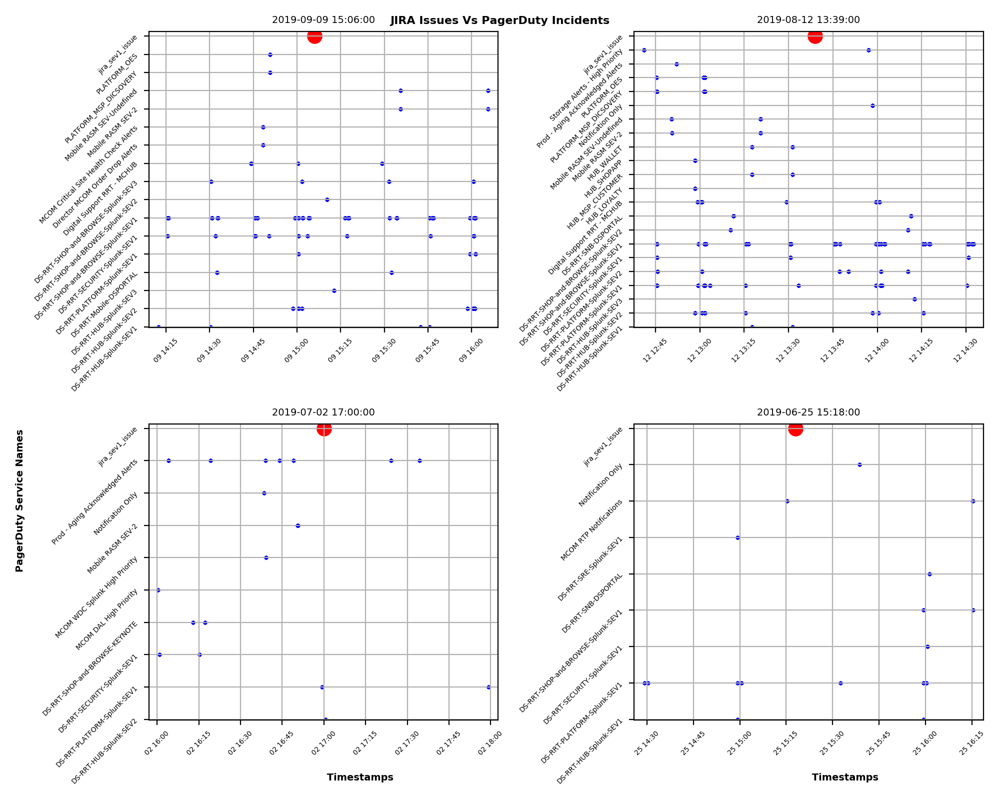

/Users/a071887/pdip/venv/lib/python3.7/site-packages/pandas/core/frame.py:7123: FutureWarning: Sorting because non-concatenation axis is not aligned. A future version
of pandas will change to not sort by default.

To accept the future behavior, pass 'sort=False'.

To retain the current behavior and silence the warning, pass 'sort=True'.

  sort=sort,


In [466]:

fig2, axs = plt.subplots(2,2)
fig2.set_figheight(8)
fig2.set_figwidth(10)
fig2.suptitle('JIRA Issues Vs PagerDuty Incidents', fontweight='bold', fontsize=8)
fig2.subplots_adjust(top=0.90)

#Filter JIRA for 2019-09-09 15:06:00
jira_created_datetime = pd.to_datetime("2019-09-09 15:06:00",utc=True)
mask = (combined['jira_created_datetime'] == jira_created_datetime)
pd_incidents_20190909_150600 = combined.loc[mask]
jira_grouped = pd_incidents_20190909_150600.groupby(['jira_created_datetime','jira_service_name']).count()['pd_description'].reset_index()
pd_incidents_grouped = pd_incidents_20190909_150600.groupby(['pd_created_datetime','pd_service_name']).count()['pd_description'].reset_index().sort_values('pd_service_name', ascending=True)
jira_plus_pd_grouped = pd_incidents_grouped.append(jira_grouped)

jiraservicenamelist = jira_grouped.jira_service_name.unique()
pdservicenamelist = pd_incidents_grouped.pd_service_name.unique()

for servicename in pdservicenamelist:
    color = 'blue'
    scale = 3
    axs[0, 0].margins(x=-0.001, y=0)
    axs[0, 0].scatter(pd_incidents_grouped['pd_created_datetime'],pd_incidents_grouped['pd_service_name'],c=color,s=scale)
for servicename in jiraservicenamelist:
    color = 'red'
    scale = 100
    axs[0, 0].margins(x=-0.001, y=0)
    axs[0, 0].scatter(jira_grouped['jira_created_datetime'],jira_grouped['jira_service_name'],c=color,s=scale)
axs[0, 0].set_title('2019-09-09 15:06:00',fontsize=7)    
axs[0, 0].grid(True)  
for tick in axs[0, 0].xaxis.get_major_ticks():
        tick.label.set_fontsize(5)  
        tick.label.set_rotation('45')
for tick in axs[0, 0].yaxis.get_major_ticks():
        tick.label.set_fontsize(5)  
        tick.label.set_rotation('45')
        
#Filter JIRA for 2019-08-12 13:39:00
jira_created_datetime = pd.to_datetime("2019-08-12 13:39:00",utc=True)
mask = (combined['jira_created_datetime'] == jira_created_datetime)
pd_incidents_20190812_133900 = combined.loc[mask]
jira_grouped = pd_incidents_20190812_133900.groupby(['jira_created_datetime','jira_service_name']).count()['pd_description'].reset_index()
pd_incidents_grouped = pd_incidents_20190812_133900.groupby(['pd_created_datetime','pd_service_name']).count()['pd_description'].reset_index().sort_values('pd_service_name', ascending=True)
jira_plus_pd_grouped = pd_incidents_grouped.append(jira_grouped)

jiraservicenamelist = jira_grouped.jira_service_name.unique()
pdservicenamelist = pd_incidents_grouped.pd_service_name.unique()

for servicename in pdservicenamelist:
    color = 'blue'
    scale = 3
    axs[0, 1].margins(x=-0.001, y=0)
    axs[0, 1].scatter(pd_incidents_grouped['pd_created_datetime'],pd_incidents_grouped['pd_service_name'],c=color,s=scale)
for servicename in jiraservicenamelist:
    color = 'red'
    scale = 100
    axs[0, 1].margins(x=-0.001, y=0)
    axs[0, 1].scatter(jira_grouped['jira_created_datetime'],jira_grouped['jira_service_name'],c=color,s=scale)
axs[0, 1].set_title('2019-08-12 13:39:00',fontsize=7)    
axs[0, 1].grid(True)  
for tick in axs[0, 1].xaxis.get_major_ticks():
        tick.label.set_fontsize(5)  
        tick.label.set_rotation('45')
for tick in axs[0, 1].yaxis.get_major_ticks():
        tick.label.set_fontsize(5)  
        tick.label.set_rotation('45')
               
#Filter JIRA for 2019-07-02 17:00:00
jira_created_datetime = pd.to_datetime("2019-07-02 17:00:00",utc=True)
mask = (combined['jira_created_datetime'] == jira_created_datetime)
pd_incidents_20190702_170000 = combined.loc[mask]
jira_grouped = pd_incidents_20190702_170000.groupby(['jira_created_datetime','jira_service_name']).count()['pd_description'].reset_index()
pd_incidents_grouped = pd_incidents_20190702_170000.groupby(['pd_created_datetime','pd_service_name']).count()['pd_description'].reset_index().sort_values('pd_service_name', ascending=True)
jira_plus_pd_grouped = pd_incidents_grouped.append(jira_grouped)

jiraservicenamelist = jira_grouped.jira_service_name.unique()
pdservicenamelist = pd_incidents_grouped.pd_service_name.unique()
for servicename in pdservicenamelist:
    color = 'blue'
    scale = 3
    axs[1, 0].margins(x=-0.001, y=0)
    axs[1, 0].scatter(pd_incidents_grouped['pd_created_datetime'],pd_incidents_grouped['pd_service_name'],c=color,s=scale)
for servicename in jiraservicenamelist:
    color = 'red'
    scale = 100
    axs[1, 0].margins(x=-0.001, y=0)
    axs[1, 0].scatter(jira_grouped['jira_created_datetime'],jira_grouped['jira_service_name'],c=color,s=scale)
axs[1, 0].set_title('2019-07-02 17:00:00',fontsize=7)    
axs[1, 0].grid(True)  
for tick in axs[1, 0].xaxis.get_major_ticks():
        tick.label.set_fontsize(5)  
        tick.label.set_rotation('45')
for tick in axs[1, 0].yaxis.get_major_ticks():
        tick.label.set_fontsize(5)  
        tick.label.set_rotation('45')
axs[1, 0].set_ylabel('PagerDuty Service Names \n',horizontalalignment='left', fontweight='bold', fontsize=7)

        
#Filter JIRA for 2019-06-25 15:18:00
jira_created_datetime = pd.to_datetime("2019-06-25 15:18:00",utc=True)
mask = (combined['jira_created_datetime'] == jira_created_datetime)
pd_incidents_20190625_151800 = combined.loc[mask]
jira_grouped = pd_incidents_20190625_151800.groupby(['jira_created_datetime','jira_service_name']).count()['pd_description'].reset_index()
pd_incidents_grouped = pd_incidents_20190625_151800.groupby(['pd_created_datetime','pd_service_name']).count()['pd_description'].reset_index().sort_values('pd_service_name', ascending=True)
jira_plus_pd_grouped = pd_incidents_grouped.append(jira_grouped)

jiraservicenamelist = jira_grouped.jira_service_name.unique()
pdservicenamelist = pd_incidents_grouped.pd_service_name.unique()

for servicename in pdservicenamelist:
    color = 'blue'
    scale = 3
    axs[1, 1].margins(x=-0.001, y=0)
    axs[1, 1].scatter(pd_incidents_grouped['pd_created_datetime'],pd_incidents_grouped['pd_service_name'],c=color,s=scale)
for servicename in jiraservicenamelist:
    color = 'red'
    scale = 100
    axs[1, 1].margins(x=-0.001, y=0)
    axs[1, 1].scatter(jira_grouped['jira_created_datetime'],jira_grouped['jira_service_name'],c=color,s=scale)
axs[1, 1].set_title('2019-06-25 15:18:00',fontsize=7)    
axs[1, 1].grid(True)  
for tick in axs[1, 1].xaxis.get_major_ticks():
        tick.label.set_fontsize(5)  
        tick.label.set_rotation('45')
for tick in axs[1, 1].yaxis.get_major_ticks():
        tick.label.set_fontsize(5)  
        tick.label.set_rotation('45')
axs[1, 0].set_xlabel('\n Timestamps',horizontalalignment='left', fontweight='bold', fontsize=7)
axs[1, 1].set_xlabel('\n Timestamps',horizontalalignment='left', fontweight='bold', fontsize=7)
fig2.tight_layout()

<IPython.core.display.Javascript object>


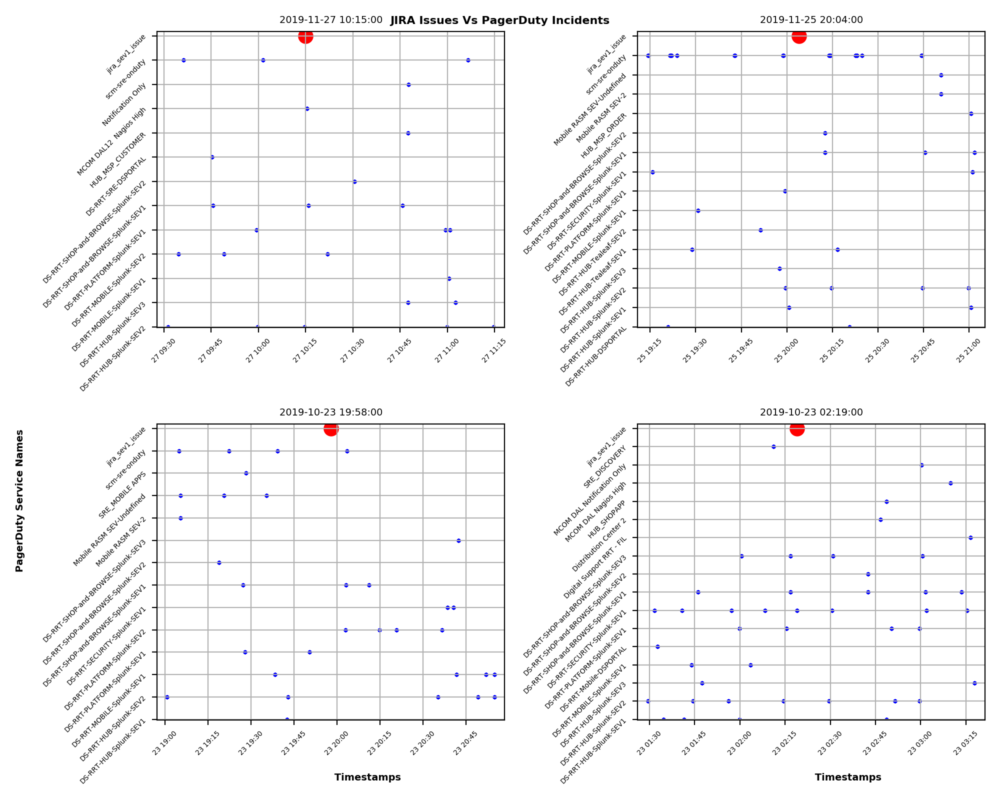

/Users/a071887/pdip/venv/lib/python3.7/site-packages/pandas/core/frame.py:7123: FutureWarning: Sorting because non-concatenation axis is not aligned. A future version
of pandas will change to not sort by default.

To accept the future behavior, pass 'sort=False'.

To retain the current behavior and silence the warning, pass 'sort=True'.

  sort=sort,


In [467]:

fig2, axs = plt.subplots(2,2)
fig2.set_figheight(8)
fig2.set_figwidth(10)
fig2.suptitle('JIRA Issues Vs PagerDuty Incidents', fontweight='bold', fontsize=8)
fig2.subplots_adjust(top=0.90)

#Filter JIRA for 2019-11-27 10:15:00
jira_created_datetime = pd.to_datetime("2019-11-27 10:15:00",utc=True)
mask = (combined['jira_created_datetime'] == jira_created_datetime)
pd_incidents_20191127_101500 = combined.loc[mask]
jira_grouped = pd_incidents_20191127_101500.groupby(['jira_created_datetime','jira_service_name']).count()['pd_description'].reset_index()
pd_incidents_grouped = pd_incidents_20191127_101500.groupby(['pd_created_datetime','pd_service_name']).count()['pd_description'].reset_index().sort_values('pd_service_name', ascending=True)
jira_plus_pd_grouped = pd_incidents_grouped.append(jira_grouped)

jiraservicenamelist = jira_grouped.jira_service_name.unique()
pdservicenamelist = pd_incidents_grouped.pd_service_name.unique()

for servicename in pdservicenamelist:
    color = 'blue'
    scale = 3
    axs[0, 0].margins(x=-0.001, y=0)
    axs[0, 0].scatter(pd_incidents_grouped['pd_created_datetime'],pd_incidents_grouped['pd_service_name'],c=color,s=scale)
for servicename in jiraservicenamelist:
    color = 'red'
    scale = 100
    axs[0, 0].margins(x=-0.001, y=0)
    axs[0, 0].scatter(jira_grouped['jira_created_datetime'],jira_grouped['jira_service_name'],c=color,s=scale)
axs[0, 0].set_title('2019-11-27 10:15:00',fontsize=7)    
axs[0, 0].grid(True)  
for tick in axs[0, 0].xaxis.get_major_ticks():
        tick.label.set_fontsize(5)  
        tick.label.set_rotation('45')
for tick in axs[0, 0].yaxis.get_major_ticks():
        tick.label.set_fontsize(5)  
        tick.label.set_rotation('45')
        
#Filter JIRA for 2019-11-25 20:04:00
jira_created_datetime = pd.to_datetime("2019-11-25 20:04:00",utc=True)
mask = (combined['jira_created_datetime'] == jira_created_datetime)
pd_incidents_20191125_200400 = combined.loc[mask]
jira_grouped = pd_incidents_20191125_200400.groupby(['jira_created_datetime','jira_service_name']).count()['pd_description'].reset_index()
pd_incidents_grouped = pd_incidents_20191125_200400.groupby(['pd_created_datetime','pd_service_name']).count()['pd_description'].reset_index().sort_values('pd_service_name', ascending=True)
jira_plus_pd_grouped = pd_incidents_grouped.append(jira_grouped)

jiraservicenamelist = jira_grouped.jira_service_name.unique()
pdservicenamelist = pd_incidents_grouped.pd_service_name.unique()

for servicename in pdservicenamelist:
    color = 'blue'
    scale = 3
    axs[0, 1].margins(x=-0.001, y=0)
    axs[0, 1].scatter(pd_incidents_grouped['pd_created_datetime'],pd_incidents_grouped['pd_service_name'],c=color,s=scale)
for servicename in jiraservicenamelist:
    color = 'red'
    scale = 100
    axs[0, 1].margins(x=-0.001, y=0)
    axs[0, 1].scatter(jira_grouped['jira_created_datetime'],jira_grouped['jira_service_name'],c=color,s=scale)
axs[0, 1].set_title('2019-11-25 20:04:00',fontsize=7)    
axs[0, 1].grid(True)  
for tick in axs[0, 1].xaxis.get_major_ticks():
        tick.label.set_fontsize(5)  
        tick.label.set_rotation('45')
for tick in axs[0, 1].yaxis.get_major_ticks():
        tick.label.set_fontsize(5)  
        tick.label.set_rotation('45')
               
#Filter JIRA for 2019-10-23 19:58:00
jira_created_datetime = pd.to_datetime("2019-10-23 19:58:00",utc=True)
mask = (combined['jira_created_datetime'] == jira_created_datetime)
pd_incidents_20191023_195800 = combined.loc[mask]
jira_grouped = pd_incidents_20191023_195800.groupby(['jira_created_datetime','jira_service_name']).count()['pd_description'].reset_index()
pd_incidents_grouped = pd_incidents_20191023_195800.groupby(['pd_created_datetime','pd_service_name']).count()['pd_description'].reset_index().sort_values('pd_service_name', ascending=True)
jira_plus_pd_grouped = pd_incidents_grouped.append(jira_grouped)

jiraservicenamelist = jira_grouped.jira_service_name.unique()
pdservicenamelist = pd_incidents_grouped.pd_service_name.unique()
for servicename in pdservicenamelist:
    color = 'blue'
    scale = 3
    axs[1, 0].margins(x=-0.001, y=0)
    axs[1, 0].scatter(pd_incidents_grouped['pd_created_datetime'],pd_incidents_grouped['pd_service_name'],c=color,s=scale)
for servicename in jiraservicenamelist:
    color = 'red'
    scale = 100
    axs[1, 0].margins(x=-0.001, y=0)
    axs[1, 0].scatter(jira_grouped['jira_created_datetime'],jira_grouped['jira_service_name'],c=color,s=scale)
axs[1, 0].set_title('2019-10-23 19:58:00',fontsize=7)    
axs[1, 0].grid(True)  
for tick in axs[1, 0].xaxis.get_major_ticks():
        tick.label.set_fontsize(5)  
        tick.label.set_rotation('45')
for tick in axs[1, 0].yaxis.get_major_ticks():
        tick.label.set_fontsize(5)  
        tick.label.set_rotation('45')
axs[1, 0].set_ylabel('PagerDuty Service Names \n',horizontalalignment='left', fontweight='bold', fontsize=7)

        
#Filter JIRA for 2019-10-23 02:19:00
jira_created_datetime = pd.to_datetime("2019-10-23 02:19:00",utc=True)
mask = (combined['jira_created_datetime'] == jira_created_datetime)
pd_incidents_20191023_021900 = combined.loc[mask]
jira_grouped = pd_incidents_20191023_021900.groupby(['jira_created_datetime','jira_service_name']).count()['pd_description'].reset_index()
pd_incidents_grouped = pd_incidents_20191023_021900.groupby(['pd_created_datetime','pd_service_name']).count()['pd_description'].reset_index().sort_values('pd_service_name', ascending=True)
jira_plus_pd_grouped = pd_incidents_grouped.append(jira_grouped)

jiraservicenamelist = jira_grouped.jira_service_name.unique()
pdservicenamelist = pd_incidents_grouped.pd_service_name.unique()

for servicename in pdservicenamelist:
    color = 'blue'
    scale = 3
    axs[1, 1].margins(x=-0.001, y=0)
    axs[1, 1].scatter(pd_incidents_grouped['pd_created_datetime'],pd_incidents_grouped['pd_service_name'],c=color,s=scale)
for servicename in jiraservicenamelist:
    color = 'red'
    scale = 100
    axs[1, 1].margins(x=-0.001, y=0)
    axs[1, 1].scatter(jira_grouped['jira_created_datetime'],jira_grouped['jira_service_name'],c=color,s=scale)
axs[1, 1].set_title('2019-10-23 02:19:00',fontsize=7)    
axs[1, 1].grid(True)  
for tick in axs[1, 1].xaxis.get_major_ticks():
        tick.label.set_fontsize(5)  
        tick.label.set_rotation('45')
for tick in axs[1, 1].yaxis.get_major_ticks():
        tick.label.set_fontsize(5)  
        tick.label.set_rotation('45')
axs[1, 0].set_xlabel('\n Timestamps',horizontalalignment='left', fontweight='bold', fontsize=7)
axs[1, 1].set_xlabel('\n Timestamps',horizontalalignment='left', fontweight='bold', fontsize=7)
fig2.tight_layout()

<IPython.core.display.Javascript object>


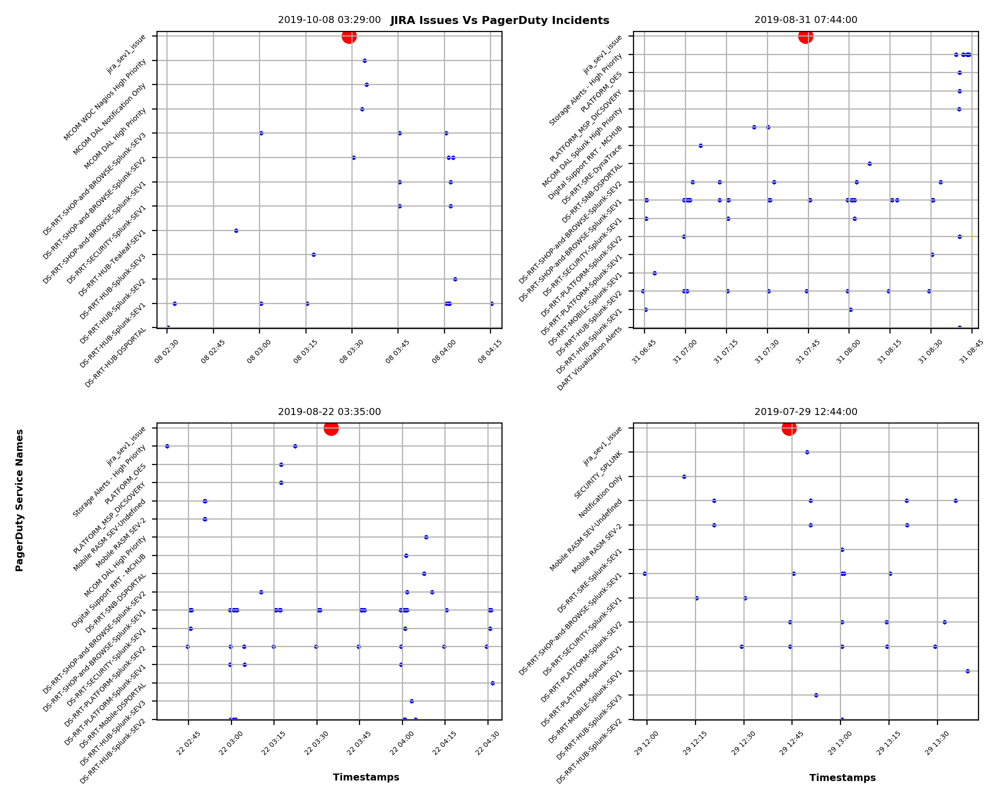

/Users/a071887/pdip/venv/lib/python3.7/site-packages/pandas/core/frame.py:7123: FutureWarning: Sorting because non-concatenation axis is not aligned. A future version
of pandas will change to not sort by default.

To accept the future behavior, pass 'sort=False'.

To retain the current behavior and silence the warning, pass 'sort=True'.

  sort=sort,


In [468]:
fig2, axs = plt.subplots(2,2)
fig2.set_figheight(8)
fig2.set_figwidth(10)
fig2.suptitle('JIRA Issues Vs PagerDuty Incidents', fontweight='bold', fontsize=8)
fig2.subplots_adjust(top=0.90)

#Filter JIRA for 2019-10-08 03:29:00
jira_created_datetime = pd.to_datetime("2019-10-08 03:29:00",utc=True)
mask = (combined['jira_created_datetime'] == jira_created_datetime)
pd_incidents_20191008_032900 = combined.loc[mask]
jira_grouped = pd_incidents_20191008_032900.groupby(['jira_created_datetime','jira_service_name']).count()['pd_description'].reset_index()
pd_incidents_grouped = pd_incidents_20191008_032900.groupby(['pd_created_datetime','pd_service_name']).count()['pd_description'].reset_index().sort_values('pd_service_name', ascending=True)
jira_plus_pd_grouped = pd_incidents_grouped.append(jira_grouped)

jiraservicenamelist = jira_grouped.jira_service_name.unique()
pdservicenamelist = pd_incidents_grouped.pd_service_name.unique()

for servicename in pdservicenamelist:
    color = 'blue'
    scale = 3
    axs[0, 0].margins(x=-0.001, y=0)
    axs[0, 0].scatter(pd_incidents_grouped['pd_created_datetime'],pd_incidents_grouped['pd_service_name'],c=color,s=scale)
for servicename in jiraservicenamelist:
    color = 'red'
    scale = 100
    axs[0, 0].margins(x=-0.001, y=0)
    axs[0, 0].scatter(jira_grouped['jira_created_datetime'],jira_grouped['jira_service_name'],c=color,s=scale)
axs[0, 0].set_title('2019-10-08 03:29:00',fontsize=7)    
axs[0, 0].grid(True)  
for tick in axs[0, 0].xaxis.get_major_ticks():
        tick.label.set_fontsize(5)  
        tick.label.set_rotation('45')
for tick in axs[0, 0].yaxis.get_major_ticks():
        tick.label.set_fontsize(5)  
        tick.label.set_rotation('45')
        
#Filter JIRA for 2019-08-31 07:44:00
jira_created_datetime = pd.to_datetime("2019-08-31 07:44:00",utc=True)
mask = (combined['jira_created_datetime'] == jira_created_datetime)
pd_incidents_20190831_074400 = combined.loc[mask]
jira_grouped = pd_incidents_20190831_074400.groupby(['jira_created_datetime','jira_service_name']).count()['pd_description'].reset_index()
pd_incidents_grouped = pd_incidents_20190831_074400.groupby(['pd_created_datetime','pd_service_name']).count()['pd_description'].reset_index().sort_values('pd_service_name', ascending=True)
jira_plus_pd_grouped = pd_incidents_grouped.append(jira_grouped)

jiraservicenamelist = jira_grouped.jira_service_name.unique()
pdservicenamelist = pd_incidents_grouped.pd_service_name.unique()

for servicename in pdservicenamelist:
    color = 'blue'
    scale = 3
    axs[0, 1].margins(x=-0.001, y=0)
    axs[0, 1].scatter(pd_incidents_grouped['pd_created_datetime'],pd_incidents_grouped['pd_service_name'],c=color,s=scale)
for servicename in jiraservicenamelist:
    color = 'red'
    scale = 100
    axs[0, 1].margins(x=-0.001, y=0)
    axs[0, 1].scatter(jira_grouped['jira_created_datetime'],jira_grouped['jira_service_name'],c=color,s=scale)
axs[0, 1].set_title('2019-08-31 07:44:00',fontsize=7)    
axs[0, 1].grid(True)  
for tick in axs[0, 1].xaxis.get_major_ticks():
        tick.label.set_fontsize(5)  
        tick.label.set_rotation('45')
for tick in axs[0, 1].yaxis.get_major_ticks():
        tick.label.set_fontsize(5)  
        tick.label.set_rotation('45')
               
#Filter JIRA for 2019-08-22 03:35:00
jira_created_datetime = pd.to_datetime("2019-08-22 03:35:00",utc=True)
mask = (combined['jira_created_datetime'] == jira_created_datetime)
pd_incidents_20190822_033500 = combined.loc[mask]
jira_grouped = pd_incidents_20190822_033500.groupby(['jira_created_datetime','jira_service_name']).count()['pd_description'].reset_index()
pd_incidents_grouped = pd_incidents_20190822_033500.groupby(['pd_created_datetime','pd_service_name']).count()['pd_description'].reset_index().sort_values('pd_service_name', ascending=True)
jira_plus_pd_grouped = pd_incidents_grouped.append(jira_grouped)

jiraservicenamelist = jira_grouped.jira_service_name.unique()
pdservicenamelist = pd_incidents_grouped.pd_service_name.unique()
for servicename in pdservicenamelist:
    color = 'blue'
    scale = 3
    axs[1, 0].margins(x=-0.001, y=0)
    axs[1, 0].scatter(pd_incidents_grouped['pd_created_datetime'],pd_incidents_grouped['pd_service_name'],c=color,s=scale)
for servicename in jiraservicenamelist:
    color = 'red'
    scale = 100
    axs[1, 0].margins(x=-0.001, y=0)
    axs[1, 0].scatter(jira_grouped['jira_created_datetime'],jira_grouped['jira_service_name'],c=color,s=scale)
axs[1, 0].set_title('2019-08-22 03:35:00',fontsize=7)    
axs[1, 0].grid(True)  
for tick in axs[1, 0].xaxis.get_major_ticks():
        tick.label.set_fontsize(5)  
        tick.label.set_rotation('45')
for tick in axs[1, 0].yaxis.get_major_ticks():
        tick.label.set_fontsize(5)  
        tick.label.set_rotation('45')
axs[1, 0].set_ylabel('PagerDuty Service Names \n',horizontalalignment='left', fontweight='bold', fontsize=7)

        
#Filter JIRA for 2019-07-29 12:44:00
jira_created_datetime = pd.to_datetime("2019-07-29 12:44:00",utc=True)
mask = (combined['jira_created_datetime'] == jira_created_datetime)
pd_incidents_20190729_124400 = combined.loc[mask]
jira_grouped = pd_incidents_20190729_124400.groupby(['jira_created_datetime','jira_service_name']).count()['pd_description'].reset_index()
pd_incidents_grouped = pd_incidents_20190729_124400.groupby(['pd_created_datetime','pd_service_name']).count()['pd_description'].reset_index().sort_values('pd_service_name', ascending=True)
jira_plus_pd_grouped = pd_incidents_grouped.append(jira_grouped)

jiraservicenamelist = jira_grouped.jira_service_name.unique()
pdservicenamelist = pd_incidents_grouped.pd_service_name.unique()

for servicename in pdservicenamelist:
    color = 'blue'
    scale = 3
    axs[1, 1].margins(x=-0.001, y=0)
    axs[1, 1].scatter(pd_incidents_grouped['pd_created_datetime'],pd_incidents_grouped['pd_service_name'],c=color,s=scale)
for servicename in jiraservicenamelist:
    color = 'red'
    scale = 100
    axs[1, 1].margins(x=-0.001, y=0)
    axs[1, 1].scatter(jira_grouped['jira_created_datetime'],jira_grouped['jira_service_name'],c=color,s=scale)
axs[1, 1].set_title('2019-07-29 12:44:00',fontsize=7)    
axs[1, 1].grid(True)  
for tick in axs[1, 1].xaxis.get_major_ticks():
        tick.label.set_fontsize(5)  
        tick.label.set_rotation('45')
for tick in axs[1, 1].yaxis.get_major_ticks():
        tick.label.set_fontsize(5)  
        tick.label.set_rotation('45')
axs[1, 0].set_xlabel('\n Timestamps',horizontalalignment='left', fontweight='bold', fontsize=7)
axs[1, 1].set_xlabel('\n Timestamps',horizontalalignment='left', fontweight='bold', fontsize=7)
fig2.tight_layout()

<IPython.core.display.Javascript object>


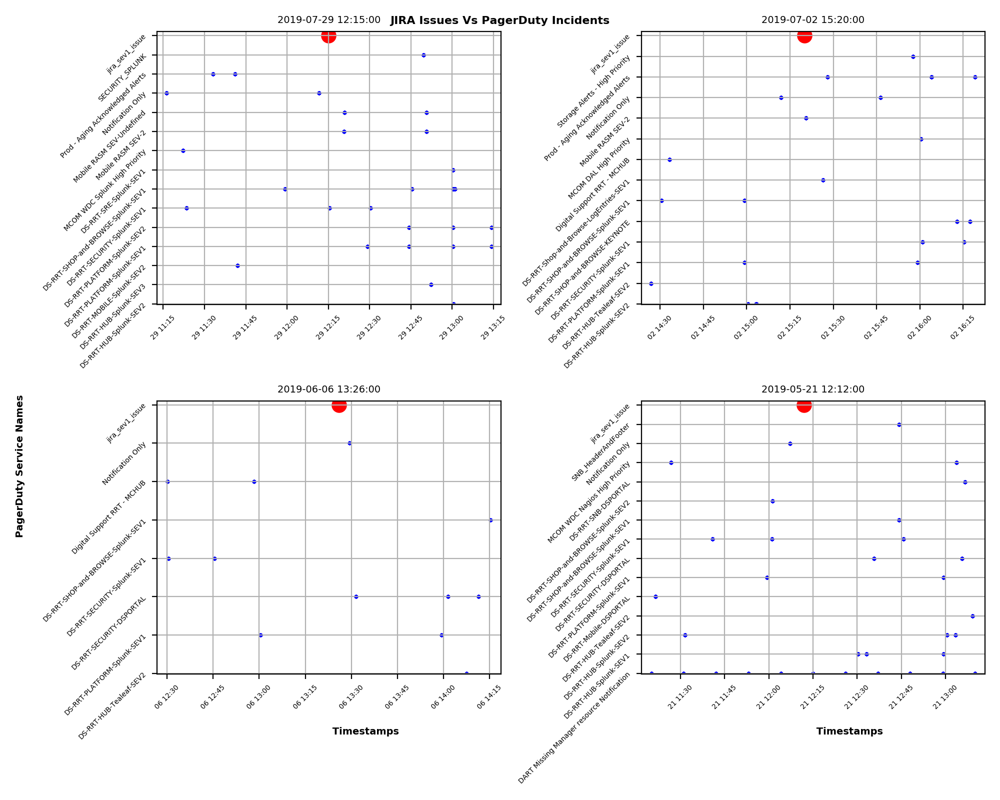

/Users/a071887/pdip/venv/lib/python3.7/site-packages/pandas/core/frame.py:7123: FutureWarning: Sorting because non-concatenation axis is not aligned. A future version
of pandas will change to not sort by default.

To accept the future behavior, pass 'sort=False'.

To retain the current behavior and silence the warning, pass 'sort=True'.

  sort=sort,


In [469]:
fig2, axs = plt.subplots(2,2)
fig2.set_figheight(8)
fig2.set_figwidth(10)
fig2.suptitle('JIRA Issues Vs PagerDuty Incidents', fontweight='bold', fontsize=8)
fig2.subplots_adjust(top=0.90)

#Filter JIRA for 2019-07-29 12:15:00
jira_created_datetime = pd.to_datetime("2019-07-29 12:15:00",utc=True)
mask = (combined['jira_created_datetime'] == jira_created_datetime)
pd_incidents_20190729_121500 = combined.loc[mask]
jira_grouped = pd_incidents_20190729_121500.groupby(['jira_created_datetime','jira_service_name']).count()['pd_description'].reset_index()
pd_incidents_grouped = pd_incidents_20190729_121500.groupby(['pd_created_datetime','pd_service_name']).count()['pd_description'].reset_index().sort_values('pd_service_name', ascending=True)
jira_plus_pd_grouped = pd_incidents_grouped.append(jira_grouped)

jiraservicenamelist = jira_grouped.jira_service_name.unique()
pdservicenamelist = pd_incidents_grouped.pd_service_name.unique()

for servicename in pdservicenamelist:
    color = 'blue'
    scale = 3
    axs[0, 0].margins(x=-0.001, y=0)
    axs[0, 0].scatter(pd_incidents_grouped['pd_created_datetime'],pd_incidents_grouped['pd_service_name'],c=color,s=scale)
for servicename in jiraservicenamelist:
    color = 'red'
    scale = 100
    axs[0, 0].margins(x=-0.001, y=0)
    axs[0, 0].scatter(jira_grouped['jira_created_datetime'],jira_grouped['jira_service_name'],c=color,s=scale)
axs[0, 0].set_title('2019-07-29 12:15:00',fontsize=7)    
axs[0, 0].grid(True)  
for tick in axs[0, 0].xaxis.get_major_ticks():
        tick.label.set_fontsize(5)  
        tick.label.set_rotation('45')
for tick in axs[0, 0].yaxis.get_major_ticks():
        tick.label.set_fontsize(5)  
        tick.label.set_rotation('45')
        
#Filter JIRA for 2019-07-02 15:20:00
jira_created_datetime = pd.to_datetime("2019-07-02 15:20:00",utc=True)
mask = (combined['jira_created_datetime'] == jira_created_datetime)
pd_incidents_20190702_152000 = combined.loc[mask]
jira_grouped = pd_incidents_20190702_152000.groupby(['jira_created_datetime','jira_service_name']).count()['pd_description'].reset_index()
pd_incidents_grouped = pd_incidents_20190702_152000.groupby(['pd_created_datetime','pd_service_name']).count()['pd_description'].reset_index().sort_values('pd_service_name', ascending=True)
jira_plus_pd_grouped = pd_incidents_grouped.append(jira_grouped)

jiraservicenamelist = jira_grouped.jira_service_name.unique()
pdservicenamelist = pd_incidents_grouped.pd_service_name.unique()

for servicename in pdservicenamelist:
    color = 'blue'
    scale = 3
    axs[0, 1].margins(x=-0.001, y=0)
    axs[0, 1].scatter(pd_incidents_grouped['pd_created_datetime'],pd_incidents_grouped['pd_service_name'],c=color,s=scale)
for servicename in jiraservicenamelist:
    color = 'red'
    scale = 100
    axs[0, 1].margins(x=-0.001, y=0)
    axs[0, 1].scatter(jira_grouped['jira_created_datetime'],jira_grouped['jira_service_name'],c=color,s=scale)
axs[0, 1].set_title('2019-07-02 15:20:00',fontsize=7)    
axs[0, 1].grid(True)  
for tick in axs[0, 1].xaxis.get_major_ticks():
        tick.label.set_fontsize(5)  
        tick.label.set_rotation('45')
for tick in axs[0, 1].yaxis.get_major_ticks():
        tick.label.set_fontsize(5)  
        tick.label.set_rotation('45')
               
#Filter JIRA for 2019-06-06 13:26:00
jira_created_datetime = pd.to_datetime("2019-06-06 13:26:00",utc=True)
mask = (combined['jira_created_datetime'] == jira_created_datetime)
pd_incidents_20190606_132600 = combined.loc[mask]
jira_grouped = pd_incidents_20190606_132600.groupby(['jira_created_datetime','jira_service_name']).count()['pd_description'].reset_index()
pd_incidents_grouped = pd_incidents_20190606_132600.groupby(['pd_created_datetime','pd_service_name']).count()['pd_description'].reset_index().sort_values('pd_service_name', ascending=True)
jira_plus_pd_grouped = pd_incidents_grouped.append(jira_grouped)

jiraservicenamelist = jira_grouped.jira_service_name.unique()
pdservicenamelist = pd_incidents_grouped.pd_service_name.unique()
for servicename in pdservicenamelist:
    color = 'blue'
    scale = 3
    axs[1, 0].margins(x=-0.001, y=0)
    axs[1, 0].scatter(pd_incidents_grouped['pd_created_datetime'],pd_incidents_grouped['pd_service_name'],c=color,s=scale)
for servicename in jiraservicenamelist:
    color = 'red'
    scale = 100
    axs[1, 0].margins(x=-0.001, y=0)
    axs[1, 0].scatter(jira_grouped['jira_created_datetime'],jira_grouped['jira_service_name'],c=color,s=scale)
axs[1, 0].set_title('2019-06-06 13:26:00',fontsize=7)    
axs[1, 0].grid(True)  
for tick in axs[1, 0].xaxis.get_major_ticks():
        tick.label.set_fontsize(5)  
        tick.label.set_rotation('45')
for tick in axs[1, 0].yaxis.get_major_ticks():
        tick.label.set_fontsize(5)  
        tick.label.set_rotation('45')
axs[1, 0].set_ylabel('PagerDuty Service Names \n',horizontalalignment='left', fontweight='bold', fontsize=7)

        
#Filter JIRA for 2019-05-21 12:12:00
jira_created_datetime = pd.to_datetime("2019-05-21 12:12:00",utc=True)
mask = (combined['jira_created_datetime'] == jira_created_datetime)
pd_incidents_20190521_121200 = combined.loc[mask]
jira_grouped = pd_incidents_20190521_121200.groupby(['jira_created_datetime','jira_service_name']).count()['pd_description'].reset_index()
pd_incidents_grouped = pd_incidents_20190521_121200.groupby(['pd_created_datetime','pd_service_name']).count()['pd_description'].reset_index().sort_values('pd_service_name', ascending=True)
jira_plus_pd_grouped = pd_incidents_grouped.append(jira_grouped)

jiraservicenamelist = jira_grouped.jira_service_name.unique()
pdservicenamelist = pd_incidents_grouped.pd_service_name.unique()

for servicename in pdservicenamelist:
    color = 'blue'
    scale = 3
    axs[1, 1].margins(x=-0.001, y=0)
    axs[1, 1].scatter(pd_incidents_grouped['pd_created_datetime'],pd_incidents_grouped['pd_service_name'],c=color,s=scale)
for servicename in jiraservicenamelist:
    color = 'red'
    scale = 100
    axs[1, 1].margins(x=-0.001, y=0)
    axs[1, 1].scatter(jira_grouped['jira_created_datetime'],jira_grouped['jira_service_name'],c=color,s=scale)
axs[1, 1].set_title('2019-05-21 12:12:00',fontsize=7)    
axs[1, 1].grid(True)  
for tick in axs[1, 1].xaxis.get_major_ticks():
        tick.label.set_fontsize(5)  
        tick.label.set_rotation('45')
for tick in axs[1, 1].yaxis.get_major_ticks():
        tick.label.set_fontsize(5)  
        tick.label.set_rotation('45')
axs[1, 0].set_xlabel('\n Timestamps',horizontalalignment='left', fontweight='bold', fontsize=7)
axs[1, 1].set_xlabel('\n Timestamps',horizontalalignment='left', fontweight='bold', fontsize=7)
fig2.tight_layout()

<IPython.core.display.Javascript object>


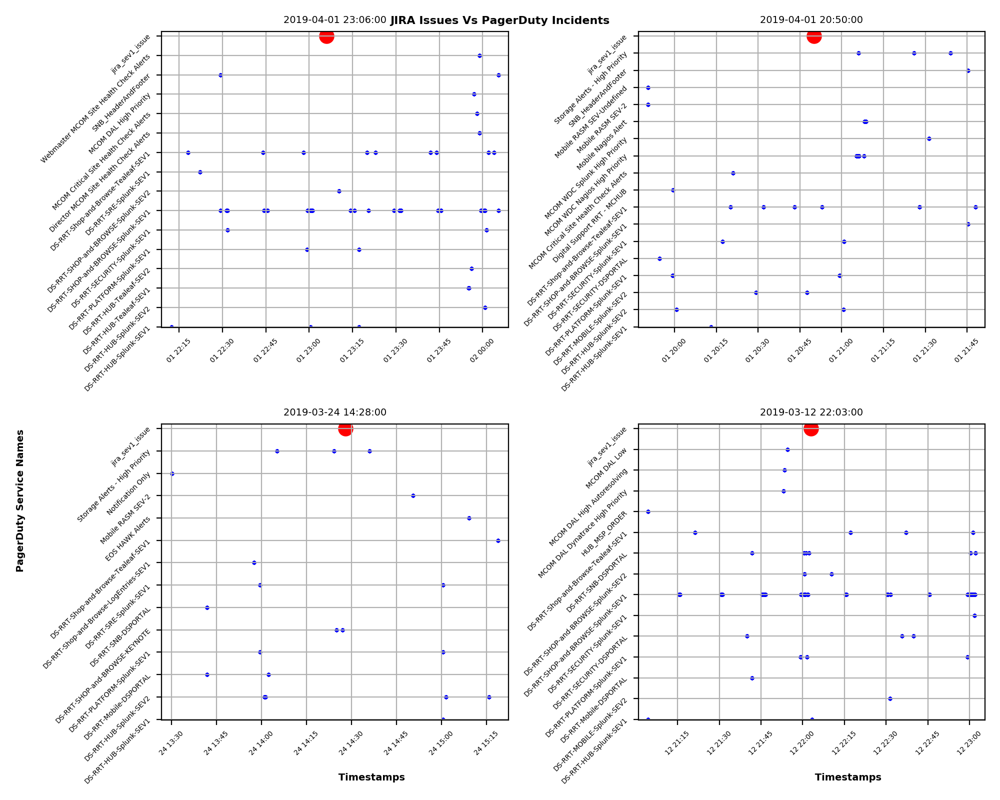

/Users/a071887/pdip/venv/lib/python3.7/site-packages/pandas/core/frame.py:7123: FutureWarning: Sorting because non-concatenation axis is not aligned. A future version
of pandas will change to not sort by default.

To accept the future behavior, pass 'sort=False'.

To retain the current behavior and silence the warning, pass 'sort=True'.

  sort=sort,


In [470]:
fig2, axs = plt.subplots(2,2)
fig2.set_figheight(8)
fig2.set_figwidth(10)
fig2.suptitle('JIRA Issues Vs PagerDuty Incidents', fontweight='bold', fontsize=8)
fig2.subplots_adjust(top=0.90)

#Filter JIRA for 2019-04-01 23:06:00
jira_created_datetime = pd.to_datetime("2019-04-01 23:06:00",utc=True)
mask = (combined['jira_created_datetime'] == jira_created_datetime)
pd_incidents_20190401_230600 = combined.loc[mask]
jira_grouped = pd_incidents_20190401_230600.groupby(['jira_created_datetime','jira_service_name']).count()['pd_description'].reset_index()
pd_incidents_grouped = pd_incidents_20190401_230600.groupby(['pd_created_datetime','pd_service_name']).count()['pd_description'].reset_index().sort_values('pd_service_name', ascending=True)
jira_plus_pd_grouped = pd_incidents_grouped.append(jira_grouped)

jiraservicenamelist = jira_grouped.jira_service_name.unique()
pdservicenamelist = pd_incidents_grouped.pd_service_name.unique()

for servicename in pdservicenamelist:
    color = 'blue'
    scale = 3
    axs[0, 0].margins(x=-0.001, y=0)
    axs[0, 0].scatter(pd_incidents_grouped['pd_created_datetime'],pd_incidents_grouped['pd_service_name'],c=color,s=scale)
for servicename in jiraservicenamelist:
    color = 'red'
    scale = 100
    axs[0, 0].margins(x=-0.001, y=0)
    axs[0, 0].scatter(jira_grouped['jira_created_datetime'],jira_grouped['jira_service_name'],c=color,s=scale)
axs[0, 0].set_title('2019-04-01 23:06:00',fontsize=7)    
axs[0, 0].grid(True)  
for tick in axs[0, 0].xaxis.get_major_ticks():
        tick.label.set_fontsize(5)  
        tick.label.set_rotation('45')
for tick in axs[0, 0].yaxis.get_major_ticks():
        tick.label.set_fontsize(5)  
        tick.label.set_rotation('45')
        
#Filter JIRA for 2019-04-01 20:50:00
jira_created_datetime = pd.to_datetime("2019-04-01 20:50:00",utc=True)
mask = (combined['jira_created_datetime'] == jira_created_datetime)
pd_incidents_20190401_205000 = combined.loc[mask]
jira_grouped = pd_incidents_20190401_205000.groupby(['jira_created_datetime','jira_service_name']).count()['pd_description'].reset_index()
pd_incidents_grouped = pd_incidents_20190401_205000.groupby(['pd_created_datetime','pd_service_name']).count()['pd_description'].reset_index().sort_values('pd_service_name', ascending=True)
jira_plus_pd_grouped = pd_incidents_grouped.append(jira_grouped)

jiraservicenamelist = jira_grouped.jira_service_name.unique()
pdservicenamelist = pd_incidents_grouped.pd_service_name.unique()

for servicename in pdservicenamelist:
    color = 'blue'
    scale = 3
    axs[0, 1].margins(x=-0.001, y=0)
    axs[0, 1].scatter(pd_incidents_grouped['pd_created_datetime'],pd_incidents_grouped['pd_service_name'],c=color,s=scale)
for servicename in jiraservicenamelist:
    color = 'red'
    scale = 100
    axs[0, 1].margins(x=-0.001, y=0)
    axs[0, 1].scatter(jira_grouped['jira_created_datetime'],jira_grouped['jira_service_name'],c=color,s=scale)
axs[0, 1].set_title('2019-04-01 20:50:00',fontsize=7)    
axs[0, 1].grid(True)  
for tick in axs[0, 1].xaxis.get_major_ticks():
        tick.label.set_fontsize(5)  
        tick.label.set_rotation('45')
for tick in axs[0, 1].yaxis.get_major_ticks():
        tick.label.set_fontsize(5)  
        tick.label.set_rotation('45')
               
#Filter JIRA for 2019-03-24 14:28:00
jira_created_datetime = pd.to_datetime("2019-03-24 14:28:00",utc=True)
mask = (combined['jira_created_datetime'] == jira_created_datetime)
pd_incidents_20190324_142800 = combined.loc[mask]
jira_grouped = pd_incidents_20190324_142800.groupby(['jira_created_datetime','jira_service_name']).count()['pd_description'].reset_index()
pd_incidents_grouped = pd_incidents_20190324_142800.groupby(['pd_created_datetime','pd_service_name']).count()['pd_description'].reset_index().sort_values('pd_service_name', ascending=True)
jira_plus_pd_grouped = pd_incidents_grouped.append(jira_grouped)

jiraservicenamelist = jira_grouped.jira_service_name.unique()
pdservicenamelist = pd_incidents_grouped.pd_service_name.unique()
for servicename in pdservicenamelist:
    color = 'blue'
    scale = 3
    axs[1, 0].margins(x=-0.001, y=0)
    axs[1, 0].scatter(pd_incidents_grouped['pd_created_datetime'],pd_incidents_grouped['pd_service_name'],c=color,s=scale)
for servicename in jiraservicenamelist:
    color = 'red'
    scale = 100
    axs[1, 0].margins(x=-0.001, y=0)
    axs[1, 0].scatter(jira_grouped['jira_created_datetime'],jira_grouped['jira_service_name'],c=color,s=scale)
axs[1, 0].set_title('2019-03-24 14:28:00',fontsize=7)    
axs[1, 0].grid(True)  
for tick in axs[1, 0].xaxis.get_major_ticks():
        tick.label.set_fontsize(5)  
        tick.label.set_rotation('45')
for tick in axs[1, 0].yaxis.get_major_ticks():
        tick.label.set_fontsize(5)  
        tick.label.set_rotation('45')
axs[1, 0].set_ylabel('PagerDuty Service Names \n',horizontalalignment='left', fontweight='bold', fontsize=7)

        
#Filter JIRA for 2019-03-12 22:03:00
jira_created_datetime = pd.to_datetime("2019-03-12 22:03:00",utc=True)
mask = (combined['jira_created_datetime'] == jira_created_datetime)
pd_incidents_20190312_220300 = combined.loc[mask]
jira_grouped = pd_incidents_20190312_220300.groupby(['jira_created_datetime','jira_service_name']).count()['pd_description'].reset_index()
pd_incidents_grouped = pd_incidents_20190312_220300.groupby(['pd_created_datetime','pd_service_name']).count()['pd_description'].reset_index().sort_values('pd_service_name', ascending=True)
jira_plus_pd_grouped = pd_incidents_grouped.append(jira_grouped)

jiraservicenamelist = jira_grouped.jira_service_name.unique()
pdservicenamelist = pd_incidents_grouped.pd_service_name.unique()

for servicename in pdservicenamelist:
    color = 'blue'
    scale = 3
    axs[1, 1].margins(x=-0.001, y=0)
    axs[1, 1].scatter(pd_incidents_grouped['pd_created_datetime'],pd_incidents_grouped['pd_service_name'],c=color,s=scale)
for servicename in jiraservicenamelist:
    color = 'red'
    scale = 100
    axs[1, 1].margins(x=-0.001, y=0)
    axs[1, 1].scatter(jira_grouped['jira_created_datetime'],jira_grouped['jira_service_name'],c=color,s=scale)
axs[1, 1].set_title('2019-03-12 22:03:00',fontsize=7)    
axs[1, 1].grid(True)  
for tick in axs[1, 1].xaxis.get_major_ticks():
        tick.label.set_fontsize(5)  
        tick.label.set_rotation('45')
for tick in axs[1, 1].yaxis.get_major_ticks():
        tick.label.set_fontsize(5)  
        tick.label.set_rotation('45')
axs[1, 0].set_xlabel('\n Timestamps',horizontalalignment='left', fontweight='bold', fontsize=7)
axs[1, 1].set_xlabel('\n Timestamps',horizontalalignment='left', fontweight='bold', fontsize=7)
fig2.tight_layout()

<IPython.core.display.Javascript object>


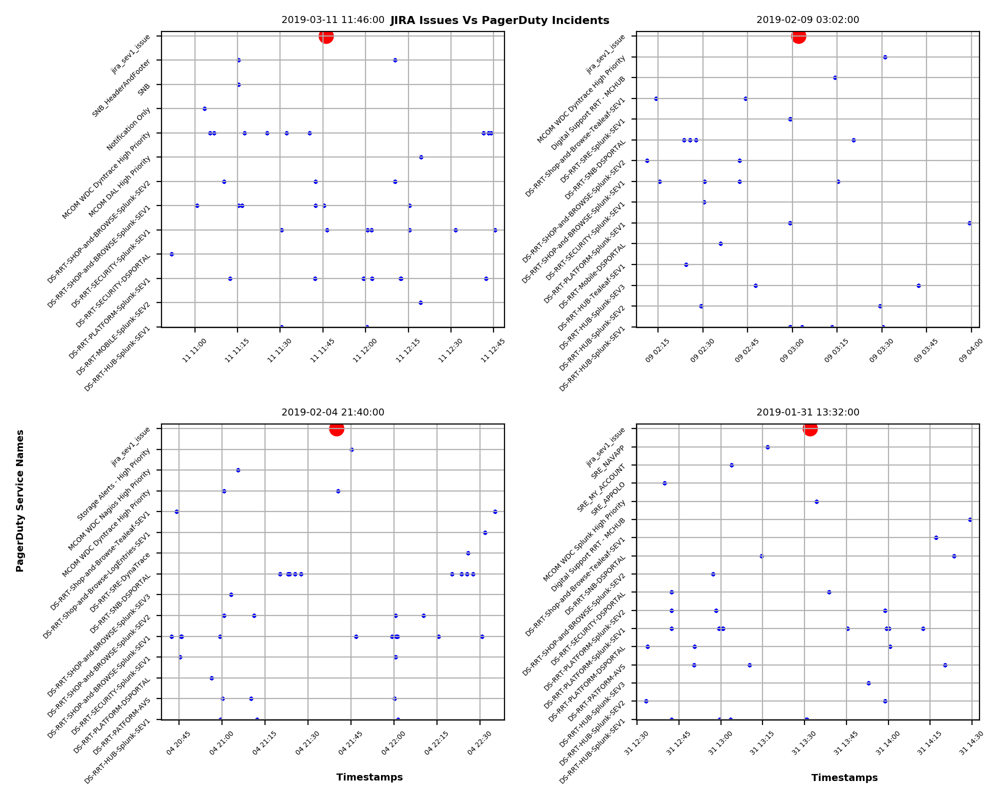

/Users/a071887/pdip/venv/lib/python3.7/site-packages/pandas/core/frame.py:7123: FutureWarning: Sorting because non-concatenation axis is not aligned. A future version
of pandas will change to not sort by default.

To accept the future behavior, pass 'sort=False'.

To retain the current behavior and silence the warning, pass 'sort=True'.

  sort=sort,


In [471]:
fig2, axs = plt.subplots(2,2)
fig2.set_figheight(8)
fig2.set_figwidth(10)
fig2.suptitle('JIRA Issues Vs PagerDuty Incidents', fontweight='bold', fontsize=8)
fig2.subplots_adjust(top=0.90)

#Filter JIRA for 2019-03-11 11:46:00
jira_created_datetime = pd.to_datetime("2019-03-11 11:46:00",utc=True)
mask = (combined['jira_created_datetime'] == jira_created_datetime)
pd_incidents_20190311_114600 = combined.loc[mask]
jira_grouped = pd_incidents_20190311_114600.groupby(['jira_created_datetime','jira_service_name']).count()['pd_description'].reset_index()
pd_incidents_grouped = pd_incidents_20190311_114600.groupby(['pd_created_datetime','pd_service_name']).count()['pd_description'].reset_index().sort_values('pd_service_name', ascending=True)
jira_plus_pd_grouped = pd_incidents_grouped.append(jira_grouped)

jiraservicenamelist = jira_grouped.jira_service_name.unique()
pdservicenamelist = pd_incidents_grouped.pd_service_name.unique()

for servicename in pdservicenamelist:
    color = 'blue'
    scale = 3
    axs[0, 0].margins(x=-0.001, y=0)
    axs[0, 0].scatter(pd_incidents_grouped['pd_created_datetime'],pd_incidents_grouped['pd_service_name'],c=color,s=scale)
for servicename in jiraservicenamelist:
    color = 'red'
    scale = 100
    axs[0, 0].margins(x=-0.001, y=0)
    axs[0, 0].scatter(jira_grouped['jira_created_datetime'],jira_grouped['jira_service_name'],c=color,s=scale)
axs[0, 0].set_title('2019-03-11 11:46:00',fontsize=7)    
axs[0, 0].grid(True)  
for tick in axs[0, 0].xaxis.get_major_ticks():
        tick.label.set_fontsize(5)  
        tick.label.set_rotation('45')
for tick in axs[0, 0].yaxis.get_major_ticks():
        tick.label.set_fontsize(5)  
        tick.label.set_rotation('45')
        
#Filter JIRA for 2019-02-09 03:02:00
jira_created_datetime = pd.to_datetime("2019-02-09 03:02:00",utc=True)
mask = (combined['jira_created_datetime'] == jira_created_datetime)
pd_incidents_20190209_030200 = combined.loc[mask]
jira_grouped = pd_incidents_20190209_030200.groupby(['jira_created_datetime','jira_service_name']).count()['pd_description'].reset_index()
pd_incidents_grouped = pd_incidents_20190209_030200.groupby(['pd_created_datetime','pd_service_name']).count()['pd_description'].reset_index().sort_values('pd_service_name', ascending=True)
jira_plus_pd_grouped = pd_incidents_grouped.append(jira_grouped)

jiraservicenamelist = jira_grouped.jira_service_name.unique()
pdservicenamelist = pd_incidents_grouped.pd_service_name.unique()

for servicename in pdservicenamelist:
    color = 'blue'
    scale = 3
    axs[0, 1].margins(x=-0.001, y=0)
    axs[0, 1].scatter(pd_incidents_grouped['pd_created_datetime'],pd_incidents_grouped['pd_service_name'],c=color,s=scale)
for servicename in jiraservicenamelist:
    color = 'red'
    scale = 100
    axs[0, 1].margins(x=-0.001, y=0)
    axs[0, 1].scatter(jira_grouped['jira_created_datetime'],jira_grouped['jira_service_name'],c=color,s=scale)
axs[0, 1].set_title('2019-02-09 03:02:00',fontsize=7)    
axs[0, 1].grid(True)  
for tick in axs[0, 1].xaxis.get_major_ticks():
        tick.label.set_fontsize(5)  
        tick.label.set_rotation('45')
for tick in axs[0, 1].yaxis.get_major_ticks():
        tick.label.set_fontsize(5)  
        tick.label.set_rotation('45')
               
#Filter JIRA for 2019-02-04 21:40:00
jira_created_datetime = pd.to_datetime("2019-02-04 21:40:00",utc=True)
mask = (combined['jira_created_datetime'] == jira_created_datetime)
pd_incidents_20190204_214000 = combined.loc[mask]
jira_grouped = pd_incidents_20190204_214000.groupby(['jira_created_datetime','jira_service_name']).count()['pd_description'].reset_index()
pd_incidents_grouped = pd_incidents_20190204_214000.groupby(['pd_created_datetime','pd_service_name']).count()['pd_description'].reset_index().sort_values('pd_service_name', ascending=True)
jira_plus_pd_grouped = pd_incidents_grouped.append(jira_grouped)

jiraservicenamelist = jira_grouped.jira_service_name.unique()
pdservicenamelist = pd_incidents_grouped.pd_service_name.unique()
for servicename in pdservicenamelist:
    color = 'blue'
    scale = 3
    axs[1, 0].margins(x=-0.001, y=0)
    axs[1, 0].scatter(pd_incidents_grouped['pd_created_datetime'],pd_incidents_grouped['pd_service_name'],c=color,s=scale)
for servicename in jiraservicenamelist:
    color = 'red'
    scale = 100
    axs[1, 0].margins(x=-0.001, y=0)
    axs[1, 0].scatter(jira_grouped['jira_created_datetime'],jira_grouped['jira_service_name'],c=color,s=scale)
axs[1, 0].set_title('2019-02-04 21:40:00',fontsize=7)    
axs[1, 0].grid(True)  
for tick in axs[1, 0].xaxis.get_major_ticks():
        tick.label.set_fontsize(5)  
        tick.label.set_rotation('45')
for tick in axs[1, 0].yaxis.get_major_ticks():
        tick.label.set_fontsize(5)  
        tick.label.set_rotation('45')
axs[1, 0].set_ylabel('PagerDuty Service Names \n',horizontalalignment='left', fontweight='bold', fontsize=7)

        
#Filter JIRA for 2019-01-31 13:32:00
jira_created_datetime = pd.to_datetime("2019-01-31 13:32:00",utc=True)
mask = (combined['jira_created_datetime'] == jira_created_datetime)
pd_incidents_20190131_133200 = combined.loc[mask]
jira_grouped = pd_incidents_20190131_133200.groupby(['jira_created_datetime','jira_service_name']).count()['pd_description'].reset_index()
pd_incidents_grouped = pd_incidents_20190131_133200.groupby(['pd_created_datetime','pd_service_name']).count()['pd_description'].reset_index().sort_values('pd_service_name', ascending=True)
jira_plus_pd_grouped = pd_incidents_grouped.append(jira_grouped)

jiraservicenamelist = jira_grouped.jira_service_name.unique()
pdservicenamelist = pd_incidents_grouped.pd_service_name.unique()

for servicename in pdservicenamelist:
    color = 'blue'
    scale = 3
    axs[1, 1].margins(x=-0.001, y=0)
    axs[1, 1].scatter(pd_incidents_grouped['pd_created_datetime'],pd_incidents_grouped['pd_service_name'],c=color,s=scale)
for servicename in jiraservicenamelist:
    color = 'red'
    scale = 100
    axs[1, 1].margins(x=-0.001, y=0)
    axs[1, 1].scatter(jira_grouped['jira_created_datetime'],jira_grouped['jira_service_name'],c=color,s=scale)
axs[1, 1].set_title('2019-01-31 13:32:00',fontsize=7)    
axs[1, 1].grid(True)  
for tick in axs[1, 1].xaxis.get_major_ticks():
        tick.label.set_fontsize(5)  
        tick.label.set_rotation('45')
for tick in axs[1, 1].yaxis.get_major_ticks():
        tick.label.set_fontsize(5)  
        tick.label.set_rotation('45')
axs[1, 0].set_xlabel('\n Timestamps',horizontalalignment='left', fontweight='bold', fontsize=7)
axs[1, 1].set_xlabel('\n Timestamps',horizontalalignment='left', fontweight='bold', fontsize=7)
fig2.tight_layout()

<IPython.core.display.Javascript object>


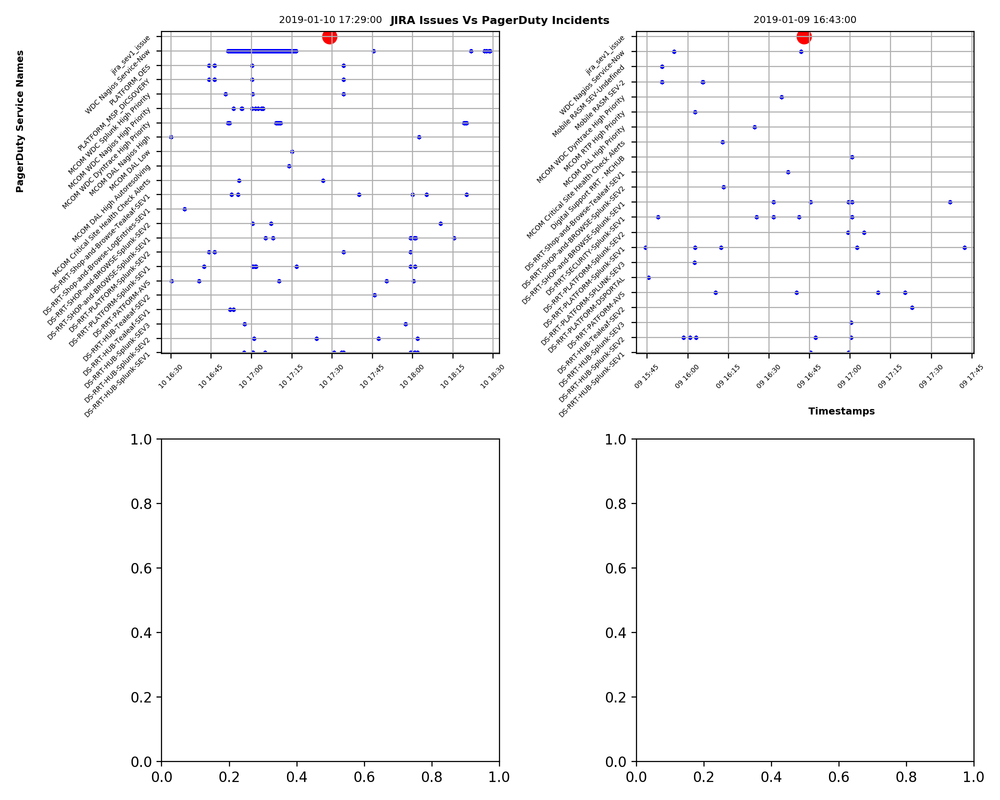

/Users/a071887/pdip/venv/lib/python3.7/site-packages/pandas/core/frame.py:7123: FutureWarning: Sorting because non-concatenation axis is not aligned. A future version
of pandas will change to not sort by default.

To accept the future behavior, pass 'sort=False'.

To retain the current behavior and silence the warning, pass 'sort=True'.

  sort=sort,


In [472]:
fig2, axs = plt.subplots(2,2)
fig2.set_figheight(8)
fig2.set_figwidth(10)
fig2.suptitle('JIRA Issues Vs PagerDuty Incidents', fontweight='bold', fontsize=8)
fig2.subplots_adjust(top=0.90)

#Filter JIRA for 2019-01-10 17:29:00
jira_created_datetime = pd.to_datetime("2019-01-10 17:29:00",utc=True)
mask = (combined['jira_created_datetime'] == jira_created_datetime)
pd_incidents_20190110_172900 = combined.loc[mask]
jira_grouped = pd_incidents_20190110_172900.groupby(['jira_created_datetime','jira_service_name']).count()['pd_description'].reset_index()
pd_incidents_grouped = pd_incidents_20190110_172900.groupby(['pd_created_datetime','pd_service_name']).count()['pd_description'].reset_index().sort_values('pd_service_name', ascending=True)
jira_plus_pd_grouped = pd_incidents_grouped.append(jira_grouped)

jiraservicenamelist = jira_grouped.jira_service_name.unique()
pdservicenamelist = pd_incidents_grouped.pd_service_name.unique()

for servicename in pdservicenamelist:
    color = 'blue'
    scale = 3
    axs[0, 0].margins(x=-0.001, y=0)
    axs[0, 0].scatter(pd_incidents_grouped['pd_created_datetime'],pd_incidents_grouped['pd_service_name'],c=color,s=scale)
for servicename in jiraservicenamelist:
    color = 'red'
    scale = 100
    axs[0, 0].margins(x=-0.001, y=0)
    axs[0, 0].scatter(jira_grouped['jira_created_datetime'],jira_grouped['jira_service_name'],c=color,s=scale)
axs[0, 0].set_title('2019-01-10 17:29:00',fontsize=7)    
axs[0, 0].grid(True)  
for tick in axs[0, 0].xaxis.get_major_ticks():
        tick.label.set_fontsize(5)  
        tick.label.set_rotation('45')
for tick in axs[0, 0].yaxis.get_major_ticks():
        tick.label.set_fontsize(5)  
        tick.label.set_rotation('45')
        
#Filter JIRA for 2019-01-09 16:43:00
jira_created_datetime = pd.to_datetime("2019-01-09 16:43:00",utc=True)
mask = (combined['jira_created_datetime'] == jira_created_datetime)
pd_incidents_20190109_164300 = combined.loc[mask]
jira_grouped = pd_incidents_20190109_164300.groupby(['jira_created_datetime','jira_service_name']).count()['pd_description'].reset_index()
pd_incidents_grouped = pd_incidents_20190109_164300.groupby(['pd_created_datetime','pd_service_name']).count()['pd_description'].reset_index().sort_values('pd_service_name', ascending=True)
jira_plus_pd_grouped = pd_incidents_grouped.append(jira_grouped)

jiraservicenamelist = jira_grouped.jira_service_name.unique()
pdservicenamelist = pd_incidents_grouped.pd_service_name.unique()

for servicename in pdservicenamelist:
    color = 'blue'
    scale = 3
    axs[0,1].margins(x=-0.001, y=0)
    axs[0,1].scatter(pd_incidents_grouped['pd_created_datetime'],pd_incidents_grouped['pd_service_name'],c=color,s=scale)
for servicename in jiraservicenamelist:
    color = 'red'
    scale = 100
    axs[0,1].margins(x=-0.001, y=0)
    axs[0,1].scatter(jira_grouped['jira_created_datetime'],jira_grouped['jira_service_name'],c=color,s=scale)
axs[0,1].set_title('2019-01-09 16:43:00',fontsize=7)    
axs[0,1].grid(True)  
for tick in axs[0,1].xaxis.get_major_ticks():
        tick.label.set_fontsize(5)  
        tick.label.set_rotation('45')
for tick in axs[0,1].yaxis.get_major_ticks():
        tick.label.set_fontsize(5)  
        tick.label.set_rotation('45')
               
axs[0,0].set_ylabel('PagerDuty Service Names \n',horizontalalignment='left', fontweight='bold', fontsize=7)

axs[0,1].set_xlabel('\n Timestamps',horizontalalignment='left', fontweight='bold', fontsize=7)
axs[0,1].set_xlabel('\n Timestamps',horizontalalignment='left', fontweight='bold', fontsize=7)
fig2.tight_layout()

## 11. Plot charts similar to section# 7 but only for few selected JIRA issues and one JIRA issue per chart and two hour time window of PagerDuty incidents - one hour before and one hour after the JIRA Issue created time. Sorted by Time in X axis.

In [553]:
import pandasql as ps
import numpy as np

#del order_to_batch_jira['description']
#del order_to_batch_jira['Description']
order_to_batch_jira['created_datetime_plus_twodays'] = order_to_batch_jira.created_datetime + pd.DateOffset(hours=2)
order_to_batch_jira['created_datetime_minus_twodays'] = order_to_batch_jira.created_datetime - pd.DateOffset(hours=2)
sqlcode_twodays = '''
select  filtered_incidents.service_name pd_service_name, 
        filtered_incidents.description pd_description,
        filtered_incidents.created_datetime pd_created_datetime,
        order_to_batch_jira.created_datetime jira_created_datetime,
        order_to_batch_jira.service_name jira_service_name
from order_to_batch_jira
left outer join filtered_incidents on filtered_incidents.created_datetime >= order_to_batch_jira.created_datetime_minus_twodays 
and filtered_incidents.created_datetime <= order_to_batch_jira.created_datetime_plus_twodays
'''
#filtered_incidents
order_to_batch_jira
combined_twodays = ps.sqldf(sqlcode_twodays,locals())
#combined_twodays
combined_twodays = combined_twodays.mask(combined_twodays.eq('None')).dropna()
combined_twodays['pd_created_datetime'] = [pd.to_datetime(d,utc=True) for d in combined_twodays['pd_created_datetime']]
combined_twodays['jira_created_datetime'] = [pd.to_datetime(d,utc=True) for d in combined_twodays['jira_created_datetime']]
#combined_twodays

<IPython.core.display.Javascript object>


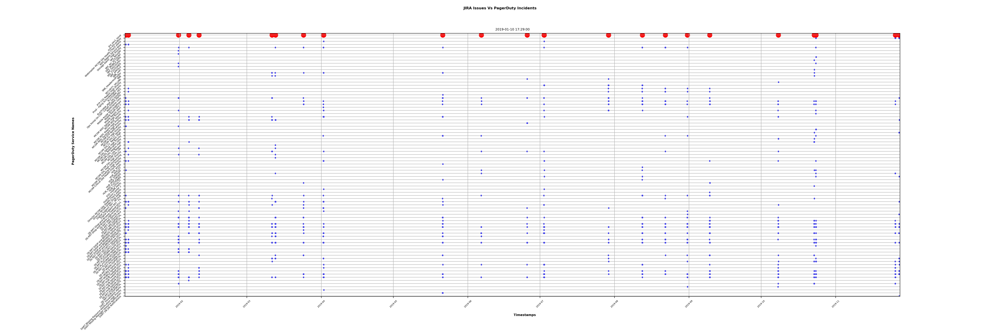

/Users/a071887/pdip/venv/lib/python3.7/site-packages/pandas/core/frame.py:7123: FutureWarning: Sorting because non-concatenation axis is not aligned. A future version
of pandas will change to not sort by default.

To accept the future behavior, pass 'sort=False'.

To retain the current behavior and silence the warning, pass 'sort=True'.

  sort=sort,


Text(0.5, 0, '\n Timestamps')

In [554]:
fig2, axs = plt.subplots()
fig2.set_figheight(10)
fig2.set_figwidth(30)
fig2.suptitle('JIRA Issues Vs PagerDuty Incidents', fontweight='bold', fontsize=8)
fig2.subplots_adjust(top=0.90)

#Filter JIRA for 2019-01-10 17:29:00
#jira_created_datetime = pd.to_datetime("2019-01-10 17:29:00",utc=True)
#mask = (combined['jira_created_datetime'] == jira_created_datetime)
#pd_incidents_20190110_172900 = combined.loc[mask]
jira_grouped = combined_twodays.groupby(['jira_created_datetime','jira_service_name']).count()['pd_description'].reset_index()
pd_incidents_grouped = combined_twodays.groupby(['pd_created_datetime','pd_service_name']).count()['pd_description'].reset_index().sort_values('pd_service_name', ascending=True)
jira_plus_pd_grouped = pd_incidents_grouped.append(jira_grouped)

jiraservicenamelist = jira_grouped.jira_service_name.unique()
pdservicenamelist = pd_incidents_grouped.pd_service_name.unique()

for servicename in pdservicenamelist:
    color = 'blue'
    scale = 3
    axs.margins(x=-0.001, y=0)
    axs.scatter(pd_incidents_grouped['pd_created_datetime'],pd_incidents_grouped['pd_service_name'],c=color,s=scale)
for servicename in jiraservicenamelist:
    color = 'red'
    scale = 100
    axs.margins(x=-0.001, y=0)
    axs.scatter(jira_grouped['jira_created_datetime'],jira_grouped['jira_service_name'],c=color,s=scale)
axs.set_title('2019-01-10 17:29:00',fontsize=7)    
axs.grid(True)  
for tick in axs.xaxis.get_major_ticks():
        tick.label.set_fontsize(5)  
        tick.label.set_rotation('45')
for tick in axs.yaxis.get_major_ticks():
        tick.label.set_fontsize(5)  
        tick.label.set_rotation('45')
                       
axs.set_ylabel('PagerDuty Service Names \n',horizontalalignment='left', fontweight='bold', fontsize=7)

axs.set_xlabel('\n Timestamps',horizontalalignment='left', fontweight='bold', fontsize=7)
axs.set_xlabel('\n Timestamps',horizontalalignment='left', fontweight='bold', fontsize=7)
#axs.plot(10,20)
#fig2.tight_layout()

In [544]:
fig2, axs = plt.subplots()
fig2.set_figheight(20)
fig2.set_figwidth(100)
fig2.suptitle('JIRA Issues Vs PagerDuty Incidents', fontweight='bold', fontsize=8)
fig2.subplots_adjust(top=0.90)

#Filter JIRA for 2019-01-10 17:29:00
#jira_created_datetime = pd.to_datetime("2019-01-10 17:29:00",utc=True)
#mask = (combined['jira_created_datetime'] == jira_created_datetime)
#pd_incidents_20190110_172900 = combined.loc[mask]
jira_grouped = combined_twodays.groupby(['jira_created_datetime','jira_service_name']).count()['pd_description'].reset_index()
pd_incidents_grouped = combined_twodays.groupby(['pd_created_datetime','pd_service_name']).count()['pd_description'].reset_index()
jira_plus_pd_grouped = pd_incidents_grouped.append(jira_grouped)

jiraservicenamelist = jira_grouped.jira_service_name.unique()
pdservicenamelist = pd_incidents_grouped.pd_service_name.unique()

for servicename in pdservicenamelist:
    color = 'blue'
    scale = 3
    axs.margins(x=-0.001, y=0)
    axs.scatter(pd_incidents_grouped['pd_created_datetime'],pd_incidents_grouped['pd_service_name'],c=color,s=scale)
for servicename in jiraservicenamelist:
    color = 'red'
    scale = 5
    axs.margins(x=-0.001, y=0)
    axs.scatter(jira_grouped['jira_created_datetime'],jira_grouped['jira_service_name'],c=color,s=scale)
    
axs.set_title('2019-01-10 17:29:00',fontsize=7)    
axs.grid(True)  
for tick in axs.xaxis.get_major_ticks():
        tick.label.set_fontsize(5)  
        tick.label.set_rotation('45')
for tick in axs.yaxis.get_major_ticks():
        tick.label.set_fontsize(5)  
        tick.label.set_rotation('45')
                       
axs.set_ylabel('PagerDuty Service Names \n',horizontalalignment='left', fontweight='bold', fontsize=7)

axs.set_xlabel('\n Timestamps',horizontalalignment='left', fontweight='bold', fontsize=7)
axs.set_xlabel('\n Timestamps',horizontalalignment='left', fontweight='bold', fontsize=7)
#fig2.plot([70, 70], [100, 250], 'k-', lw=2)
#plt.axvline(x=10)
#fig2.lines([jira_grouped['jira_created_datetime'] - pd.DateOffset(hours=2), 0], [jira_grouped['jira_created_datetime'] + pd.DateOffset(hours=2), 20], 'k-', lw=2)
#fig2.tight_layout()

<IPython.core.display.Javascript object>

/Users/a071887/pdip/venv/lib/python3.7/site-packages/pandas/core/frame.py:7123: FutureWarning: Sorting because non-concatenation axis is not aligned. A future version
of pandas will change to not sort by default.

To accept the future behavior, pass 'sort=False'.

To retain the current behavior and silence the warning, pass 'sort=True'.

  sort=sort,


Text(0.5, 0, '\n Timestamps')

## Plot chart with service name like "SHOP_and_Browse"

In [509]:
#import pandasql as ps
#import numpy as np

order_to_batch_jira['created_datetime_plus_twodays'] = order_to_batch_jira.created_datetime + pd.DateOffset(days=2)
order_to_batch_jira['created_datetime_minus_twodays'] = order_to_batch_jira.created_datetime - pd.DateOffset(days=2)
sqlcode = '''
select  filtered_incidents.service_name pd_service_name, 
        filtered_incidents.description pd_description,
        filtered_incidents.created_datetime pd_created_datetime,
        order_to_batch_jira.created_datetime jira_created_datetime,
        order_to_batch_jira.service_name jira_service_name
from order_to_batch_jira
left outer join filtered_incidents on filtered_incidents.created_datetime >= order_to_batch_jira.created_datetime_minus_twodays 
and filtered_incidents.created_datetime <= order_to_batch_jira.created_datetime_plus_twodays
'''
combined_two_days = ps.sqldf(sqlcode,locals())
combined_two_days = combined_two_days.mask(combined_two_days.eq('None')).dropna()
combined_two_days['pd_created_datetime'] = [pd.to_datetime(d,utc=True) for d in combined_two_days['pd_created_datetime']]
combined_two_days['jira_created_datetime'] = [pd.to_datetime(d,utc=True) for d in combined_two_days['jira_created_datetime']]
#combined_two_days
temp_sab_1 = combined_two_days[combined_two_days['pd_service_name'] == "DS-RRT-SHOP-and-BROWSE-Splunk-SEV1"]
temp_sab_2 = combined_two_days[combined_two_days['pd_service_name'] == "DS-RRT-SHOP-and-BROWSE-Splunk-SEV2"]
temp_sab_3 = combined_two_days[combined_two_days['pd_service_name'] == "DS-RRT-SHOP-and-BROWSE-Splunk-SEV3"]
temp_sab_4 = temp_sab_1.append(temp_sab_2)
temp_sab_5 = temp_sab_4.append(temp_sab_3)
pd_incidents_sab = temp_sab_5
#pdservicenamelist_sab = temp_sab_5.pd_service_name.unique()
#pdservicenamelist_sab

<IPython.core.display.Javascript object>


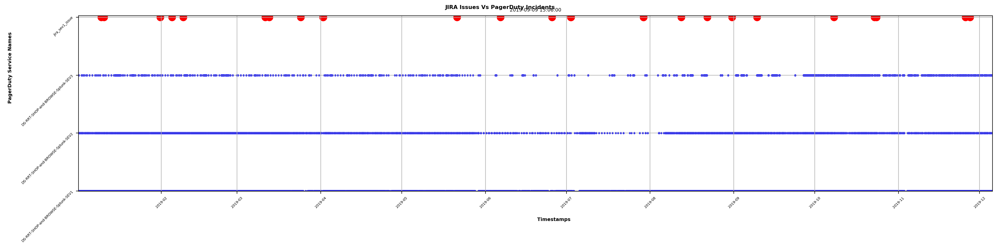

/Users/a071887/pdip/venv/lib/python3.7/site-packages/pandas/core/frame.py:7123: FutureWarning: Sorting because non-concatenation axis is not aligned. A future version
of pandas will change to not sort by default.

To accept the future behavior, pass 'sort=False'.

To retain the current behavior and silence the warning, pass 'sort=True'.

  sort=sort,


In [512]:
temp_sab_1 = filtered_incidents[filtered_incidents['service_name'] == "DS-RRT-SHOP-and-BROWSE-Splunk-SEV1"]
temp_sab_2 = filtered_incidents[filtered_incidents['service_name'] == "DS-RRT-SHOP-and-BROWSE-Splunk-SEV2"]
temp_sab_3 = filtered_incidents[filtered_incidents['service_name'] == "DS-RRT-SHOP-and-BROWSE-Splunk-SEV3"]
temp_sab_4 = temp_sab_1.append(temp_sab_2)
temp_sab_5 = temp_sab_4.append(temp_sab_3)
pd_incidents_sab = temp_sab_5

fig2, axs = plt.subplots(1,1)
fig2.set_figheight(5)
fig2.set_figwidth(20)
fig2.suptitle('JIRA Issues Vs PagerDuty Incidents', fontweight='bold', fontsize=8)
fig2.subplots_adjust(top=0.90)

#Filter - no filter
jira_grouped = order_to_batch_jira_sab.groupby(['created_datetime','service_name']).count()['description'].reset_index()
pd_incidents_grouped = pd_incidents_sab.groupby(['created_datetime','service_name']).count()['description'].reset_index().sort_values('service_name', ascending=True)
jira_plus_pd_grouped = pd_incidents_sab.append(jira_grouped)

jiraservicenamelist = jira_grouped.service_name.unique()
pdservicenamelist = pd_incidents_grouped.service_name.unique()

for servicename in pdservicenamelist:
    color = 'blue'
    scale = 3
    axs.margins(x=-0.001, y=0)
    axs.scatter(pd_incidents_grouped['created_datetime'],pd_incidents_grouped['service_name'],c=color,s=scale)
for servicename in jiraservicenamelist:
    color = 'red'
    scale = 100
    axs.margins(x=-0.001, y=0)
    axs.scatter(jira_grouped['created_datetime'],jira_grouped['service_name'],c=color,s=scale)
axs.set_title('2019-09-09 15:06:00',fontsize=7)    
axs.grid(True)  
for tick in axs.xaxis.get_major_ticks():
        tick.label.set_fontsize(5)  
        tick.label.set_rotation('45')
for tick in axs.yaxis.get_major_ticks():
        tick.label.set_fontsize(5)  
        tick.label.set_rotation('45')
axs.set_ylabel('PagerDuty Service Names \n',horizontalalignment='left', fontweight='bold', fontsize=7)
axs.set_xlabel('\n Timestamps',horizontalalignment='left', fontweight='bold', fontsize=7)
axs.set_xlabel('\n Timestamps',horizontalalignment='left', fontweight='bold', fontsize=7)
fig2.tight_layout()

In [581]:
import matplotlib.dates as mdates
startdate = pd.to_datetime("2019-01-01").date()
enddate = pd.to_datetime("2019-11-30").date()
sev_mask = (sev_compact['created_date'] >= startdate) & (sev_compact['created_date'] <= enddate)
sev_all = sev_compact_datetime.loc[sev_mask]
sev_grouped = sev_all.groupby(['created_datetime','created_time','service_name']).count()['description'].reset_index()
sev_plus_grouped = grouped.append(sev_grouped)

fig1, ax1 = plt.subplots()
fig1.set_figheight(25)
fig1.set_figwidth(200)
hours = mdates.HourLocator(interval = 12)
hours.MAXTICKS = 1500
servicenamelist = sev_plus_grouped.service_name.unique()

for servicename in servicenamelist:
    if servicename == 'jira_sev1_issue':
        color = 'red'
        scale = 50
        ax1.margins(x=-0.01, y=0)
        ax1.scatter(sev_grouped['created_datetime'],sev_grouped['service_name'],c=color,s=scale)
        ax1.xaxis.set_major_locator(hours)
    else:
        color = 'blue'
        scale = 3
        ax1.margins(x=-0.01, y=0)
        ax1.scatter(grouped['created_datetime'],grouped['service_name'],c=color,s=scale)
        ax1.xaxis.set_major_locator(hours)
for tick in ax1.xaxis.get_major_ticks():
        tick.label.set_fontsize(5)  
        tick.label.set_rotation('45')
for tick in ax1.yaxis.get_major_ticks():
        tick.label.set_fontsize(5)  
        tick.label.set_rotation('45')
ax1.set_ylabel('PagerDuty Service Names \n',horizontalalignment='center', fontweight='bold', fontsize=7)
ax1.set_xlabel('\n Timestamps',horizontalalignment='center', fontweight='bold', fontsize=7)

ax1.grid(True)

/Users/a071887/pdip/venv/lib/python3.7/site-packages/ipykernel_launcher.py:9: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  if __name__ == '__main__':


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>


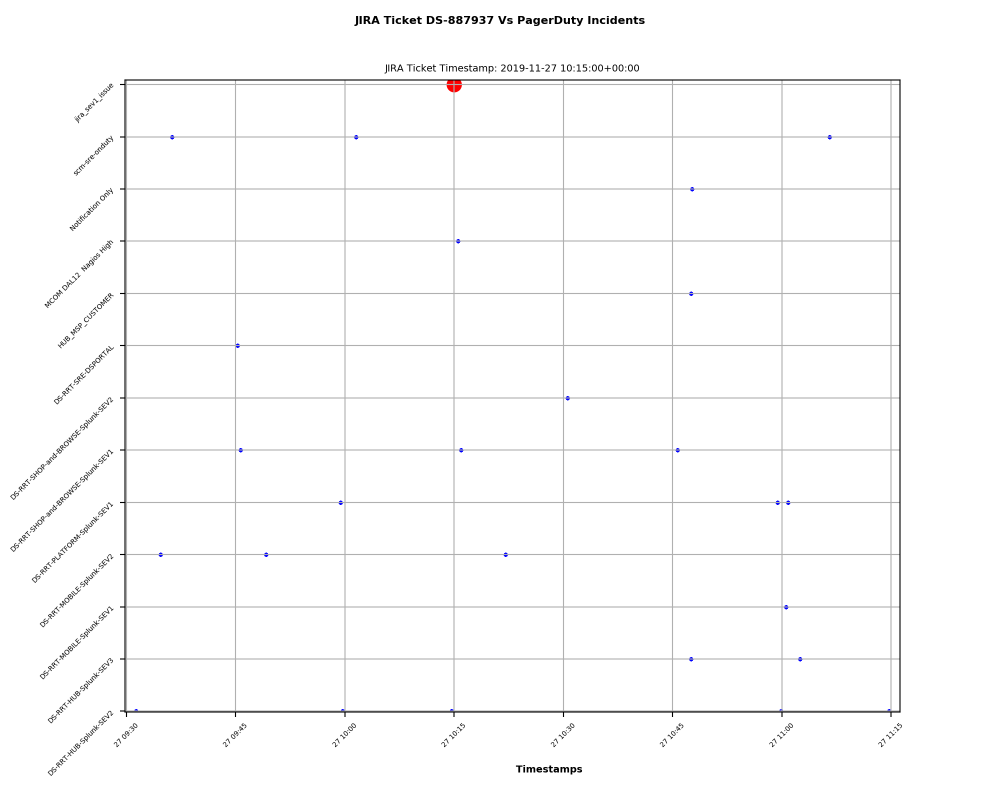

/Users/a071887/pdip/venv/lib/python3.7/site-packages/pandas/core/frame.py:7123: FutureWarning: Sorting because non-concatenation axis is not aligned. A future version
of pandas will change to not sort by default.

To accept the future behavior, pass 'sort=False'.

To retain the current behavior and silence the warning, pass 'sort=True'.

  sort=sort,


<IPython.core.display.Javascript object>


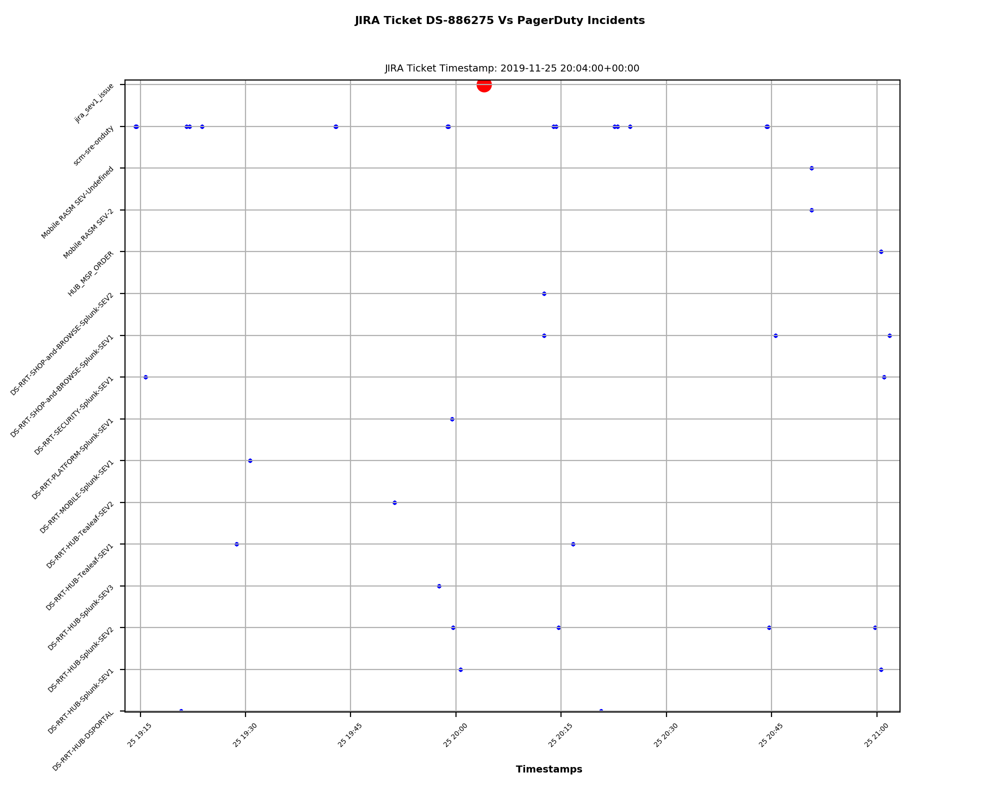

<IPython.core.display.Javascript object>


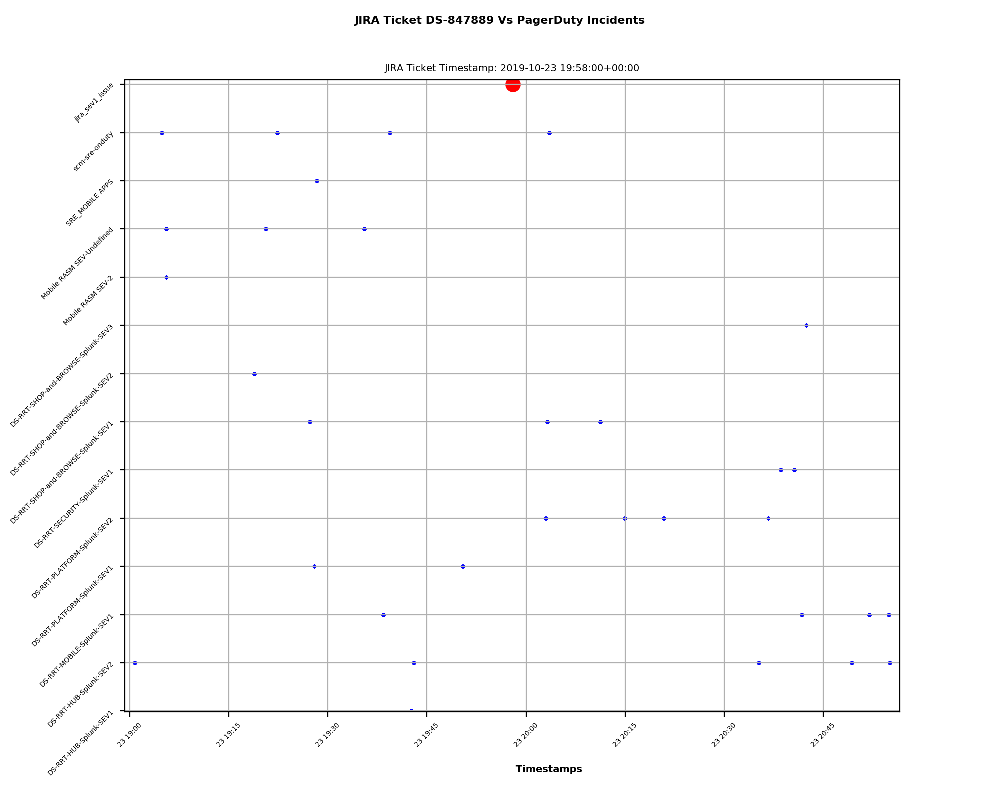

<IPython.core.display.Javascript object>


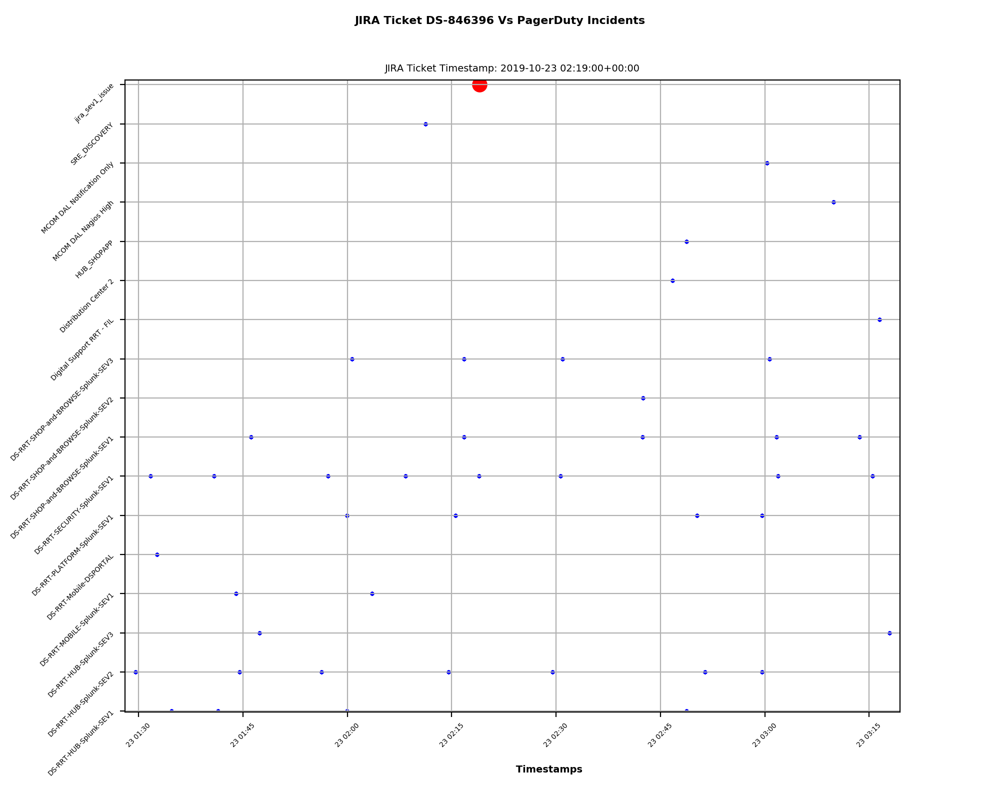

<IPython.core.display.Javascript object>


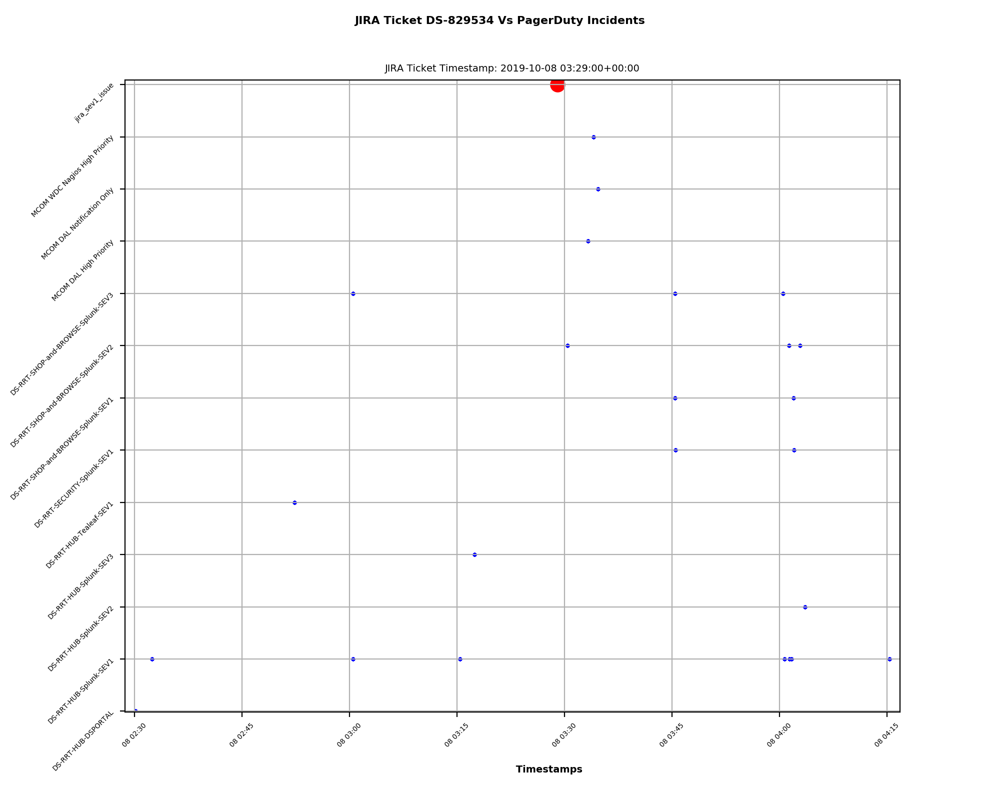

<IPython.core.display.Javascript object>


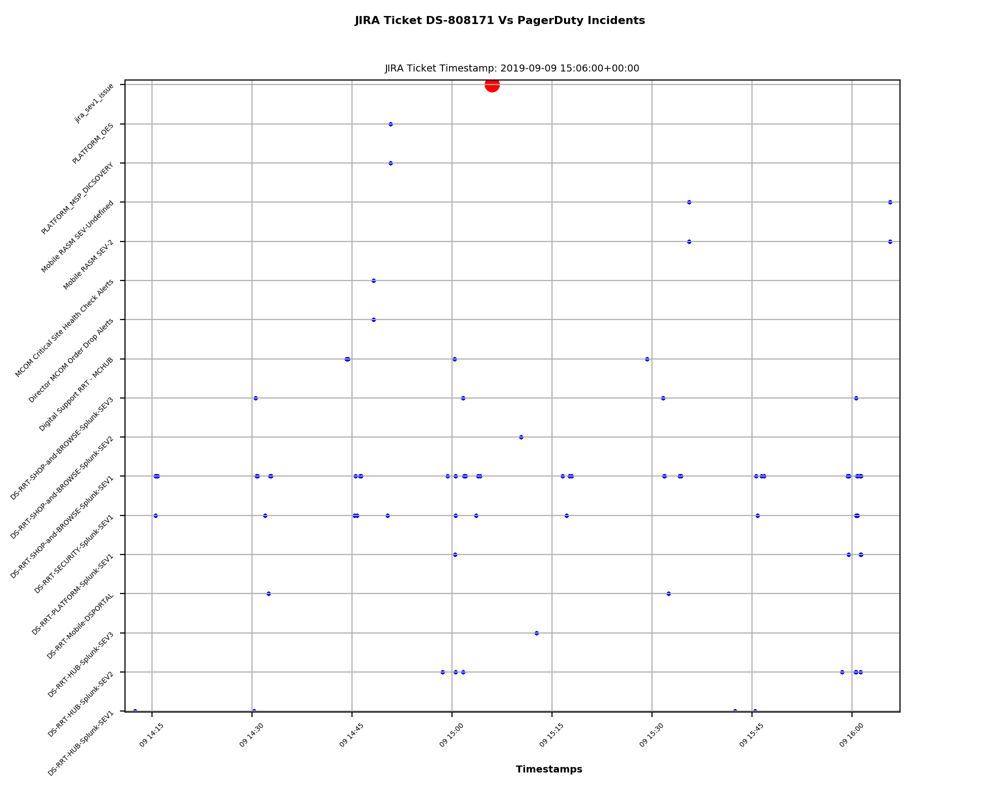

<IPython.core.display.Javascript object>


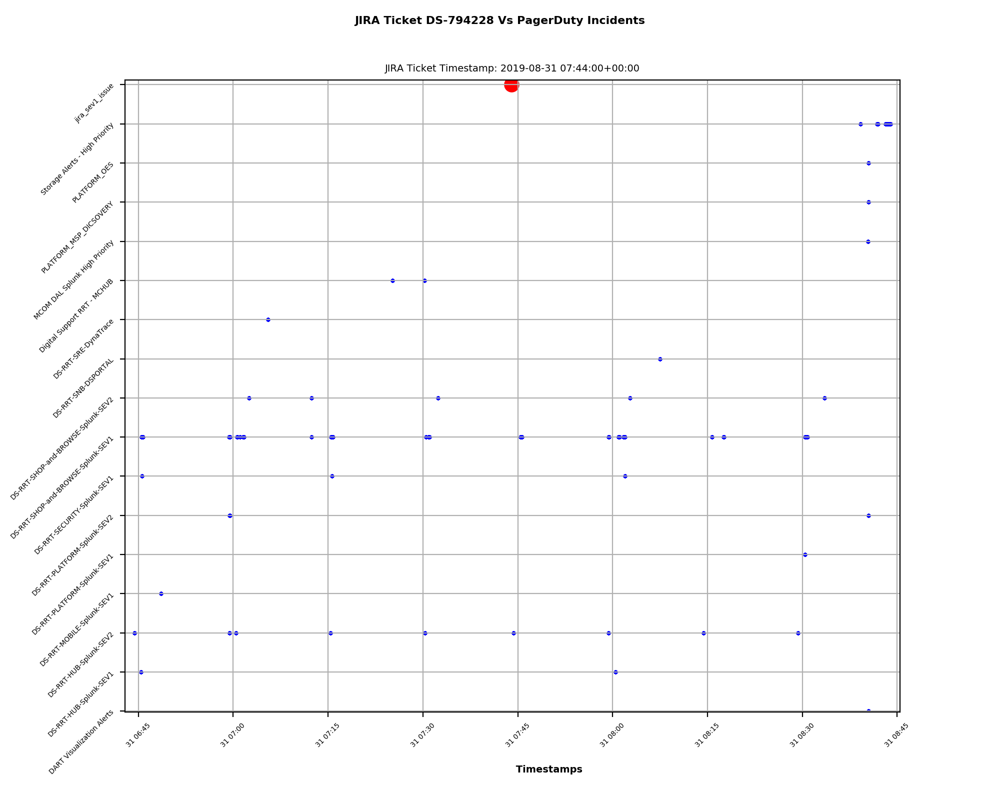

<IPython.core.display.Javascript object>


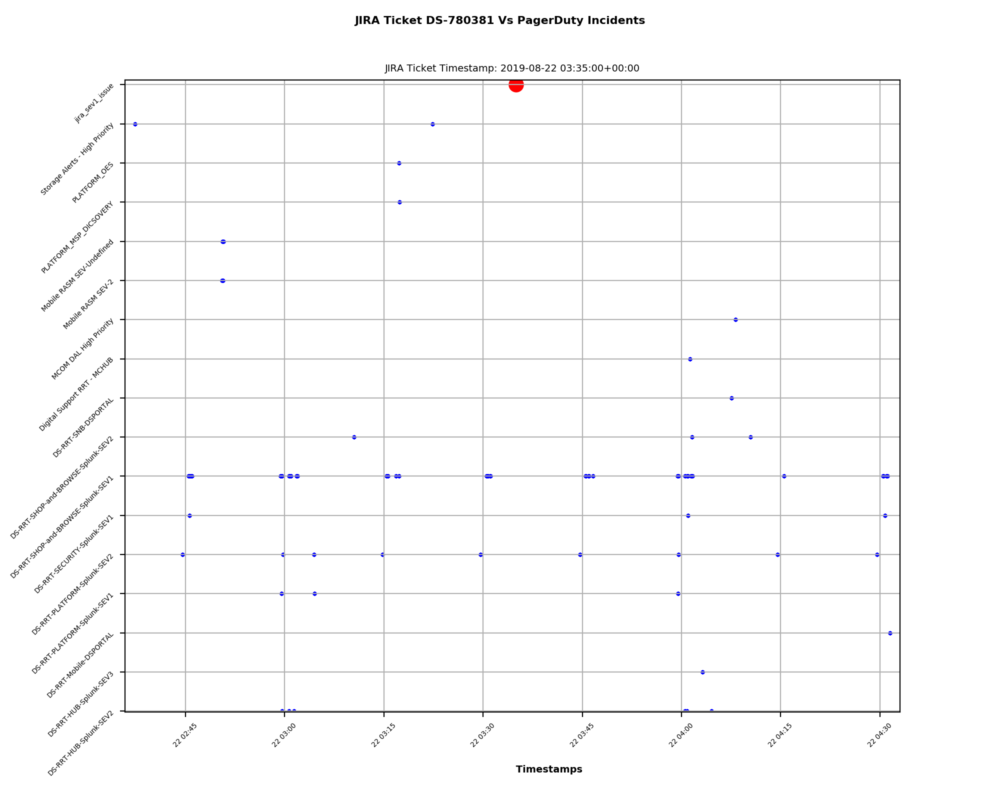

<IPython.core.display.Javascript object>


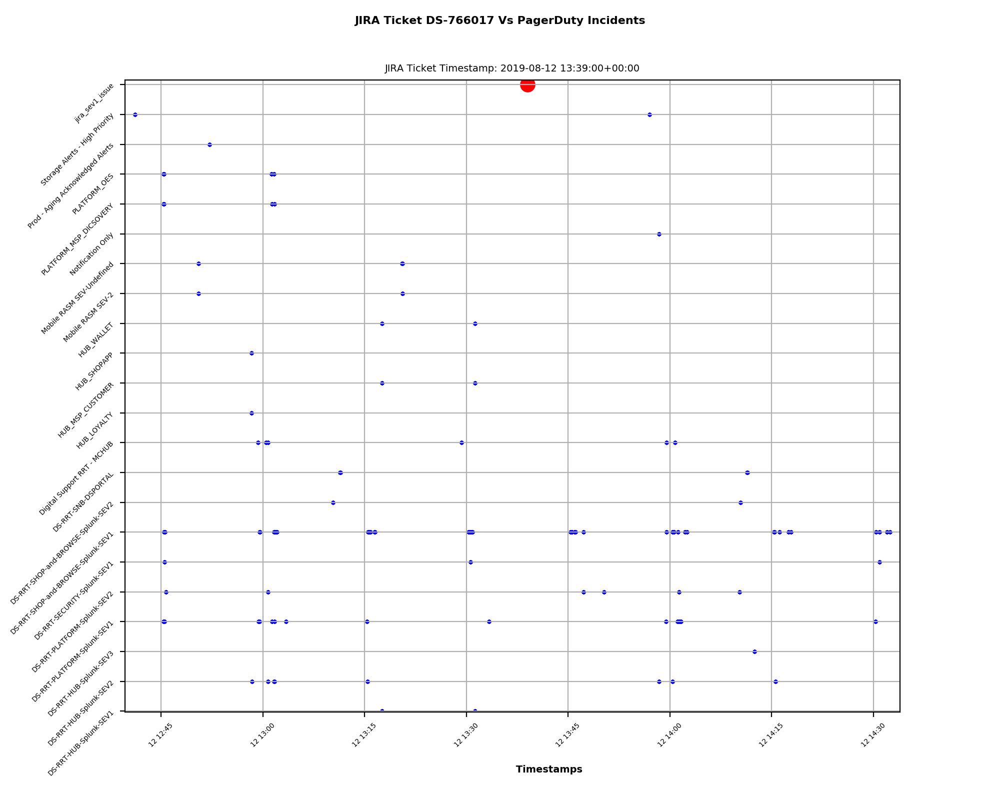

<IPython.core.display.Javascript object>


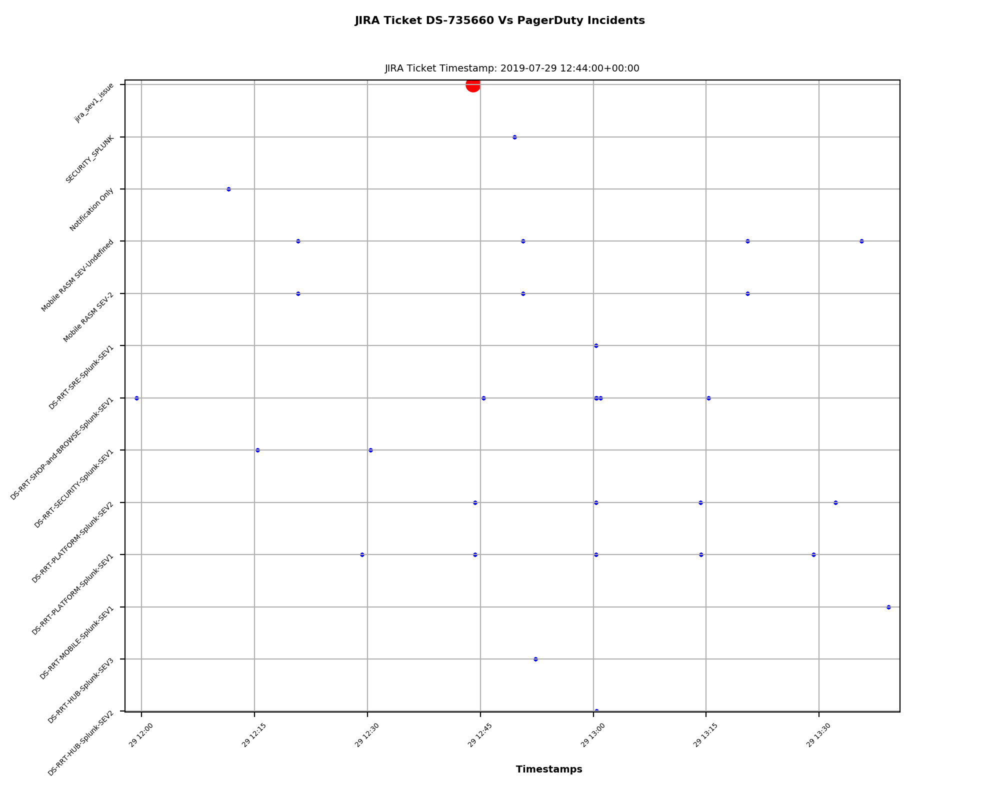

<IPython.core.display.Javascript object>


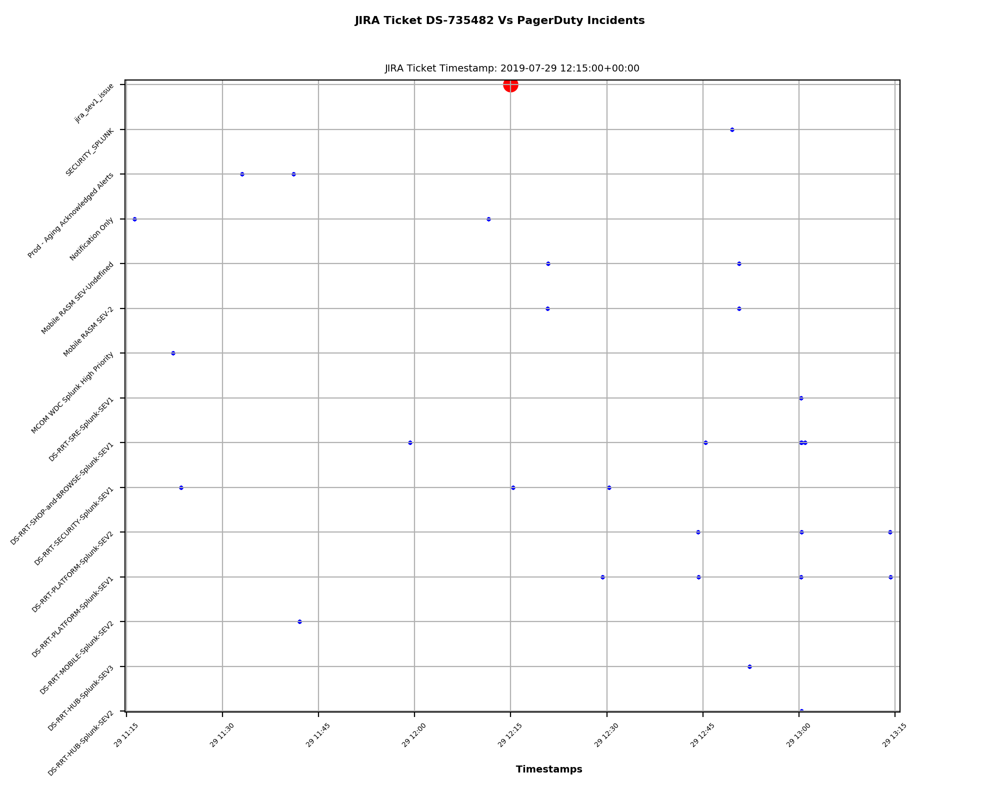

<IPython.core.display.Javascript object>


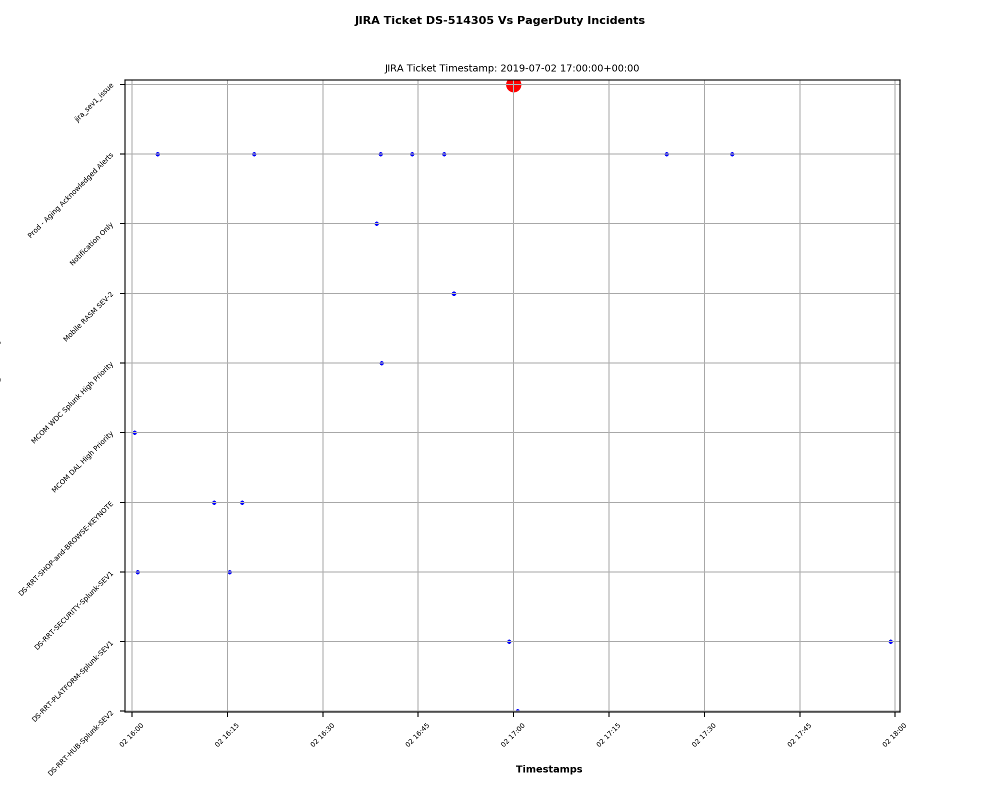

<IPython.core.display.Javascript object>


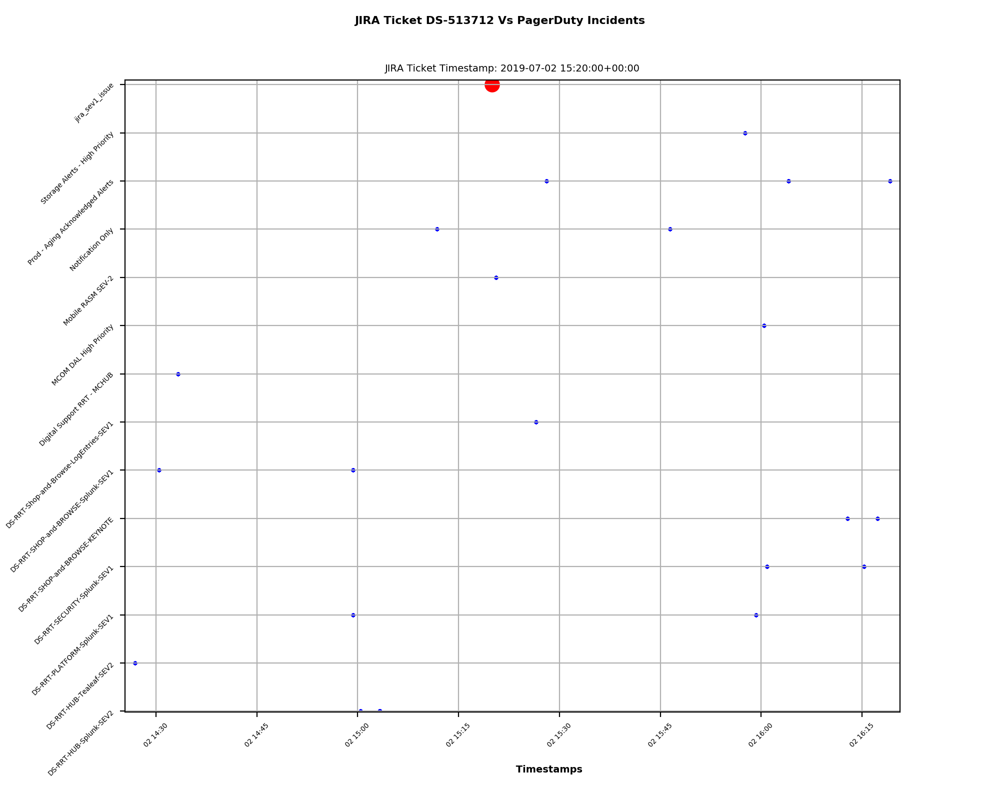

<IPython.core.display.Javascript object>


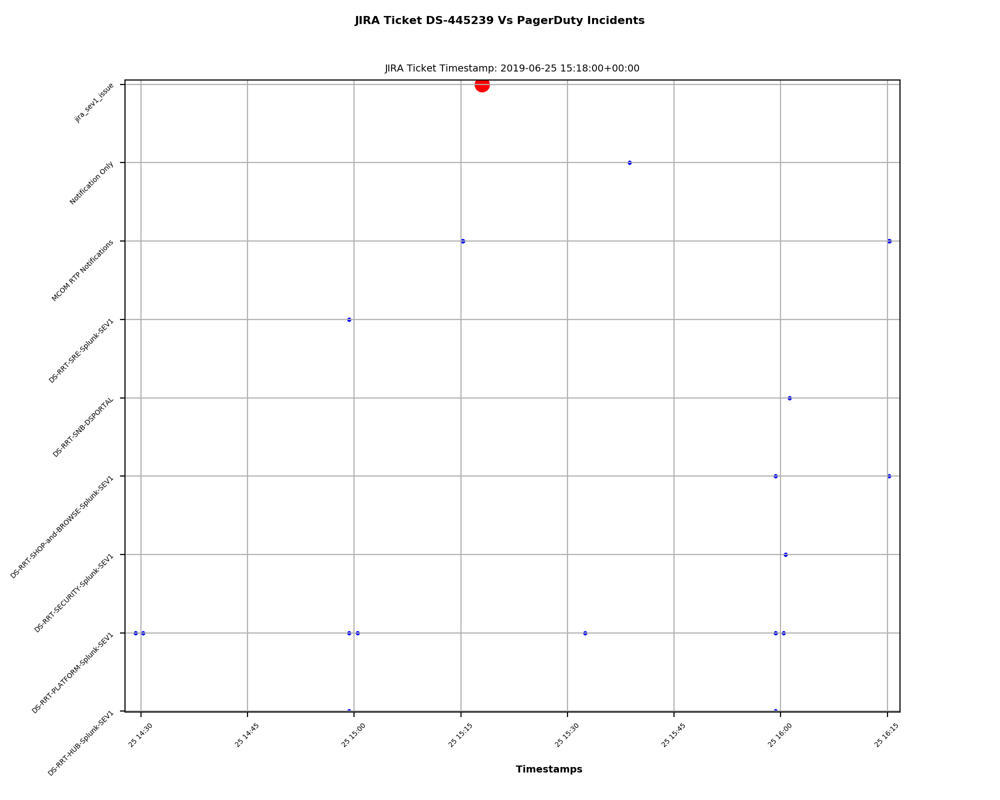

<IPython.core.display.Javascript object>


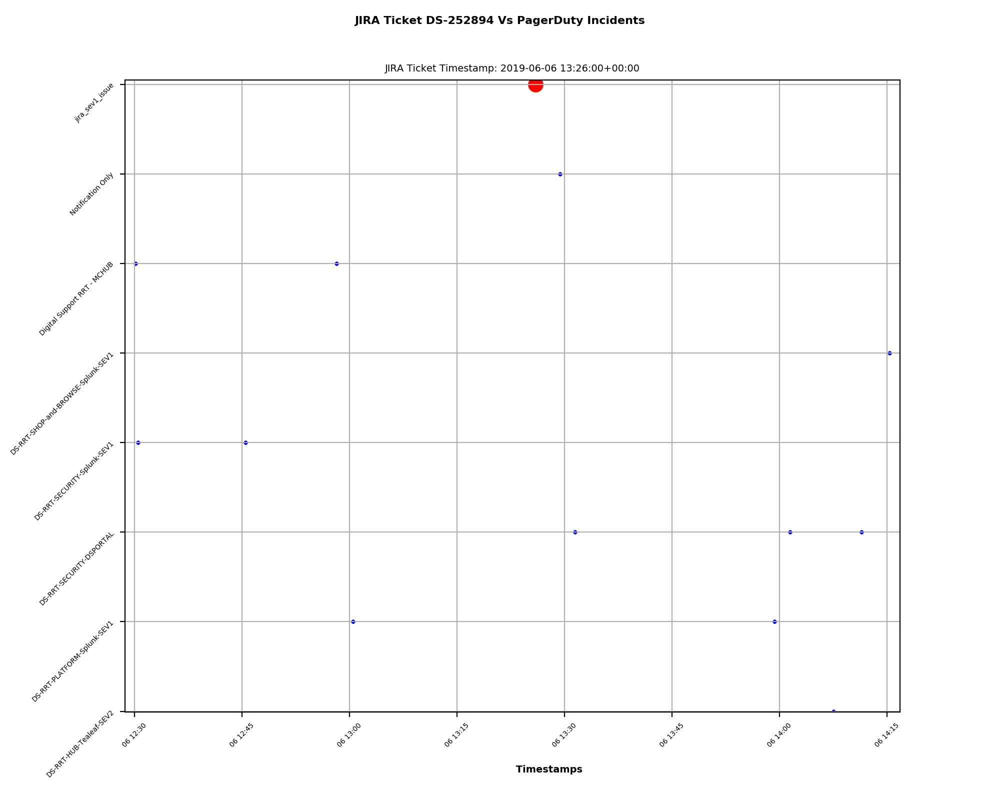

<IPython.core.display.Javascript object>


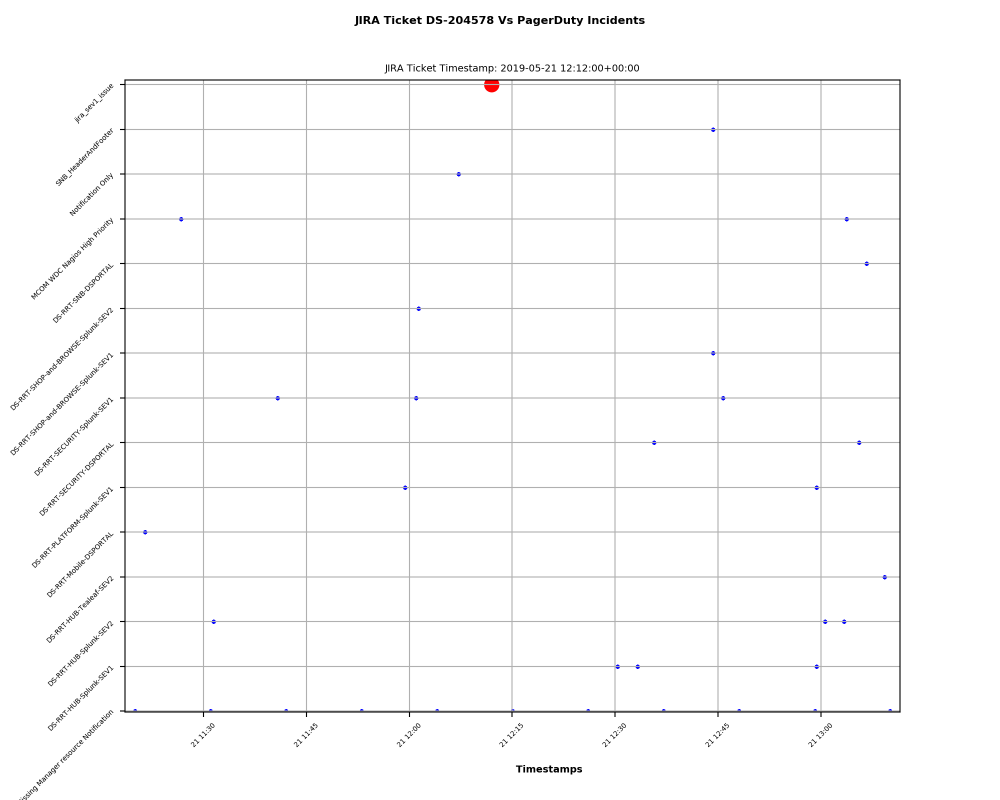

<IPython.core.display.Javascript object>


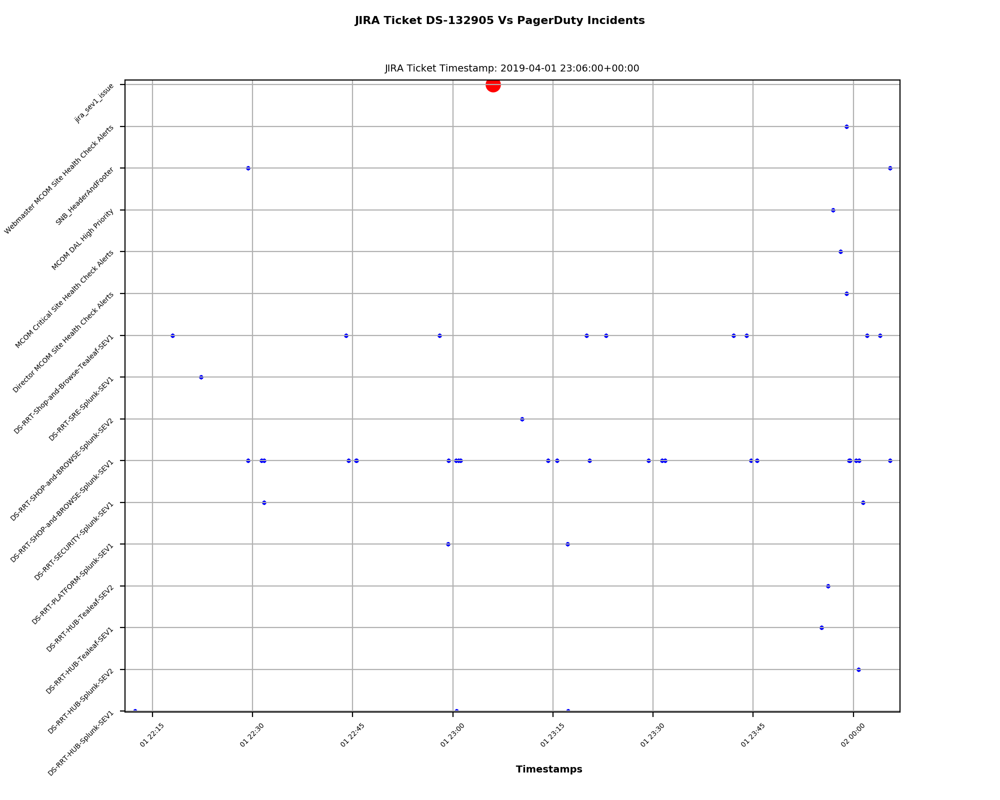

<IPython.core.display.Javascript object>


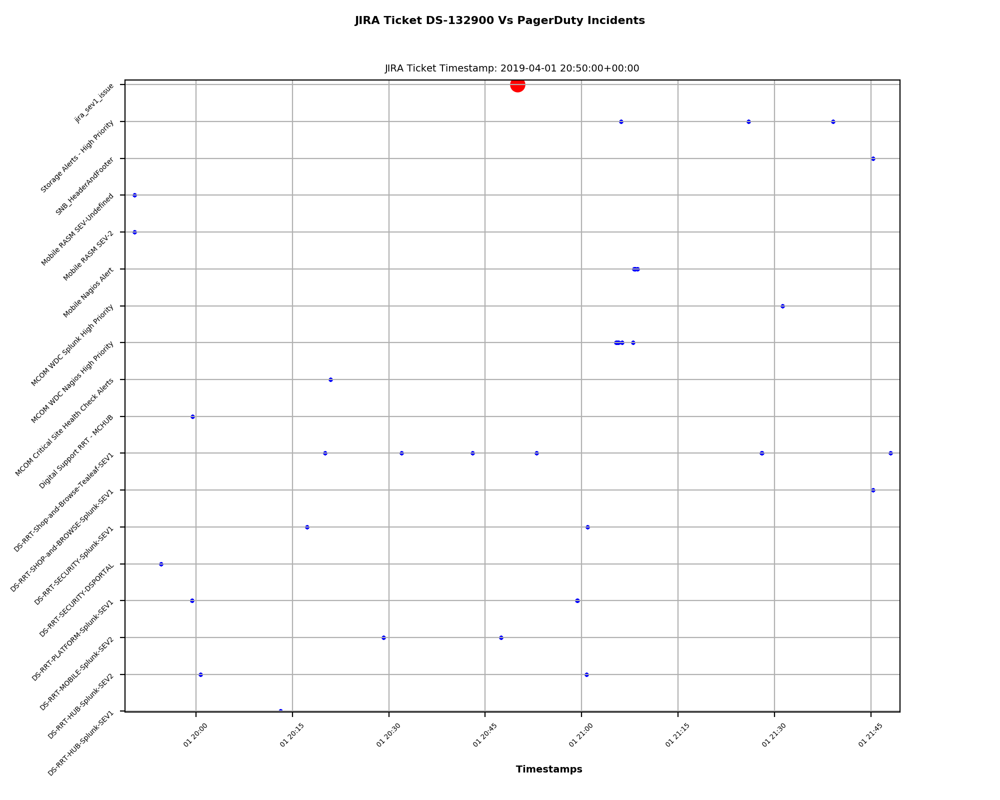

<IPython.core.display.Javascript object>


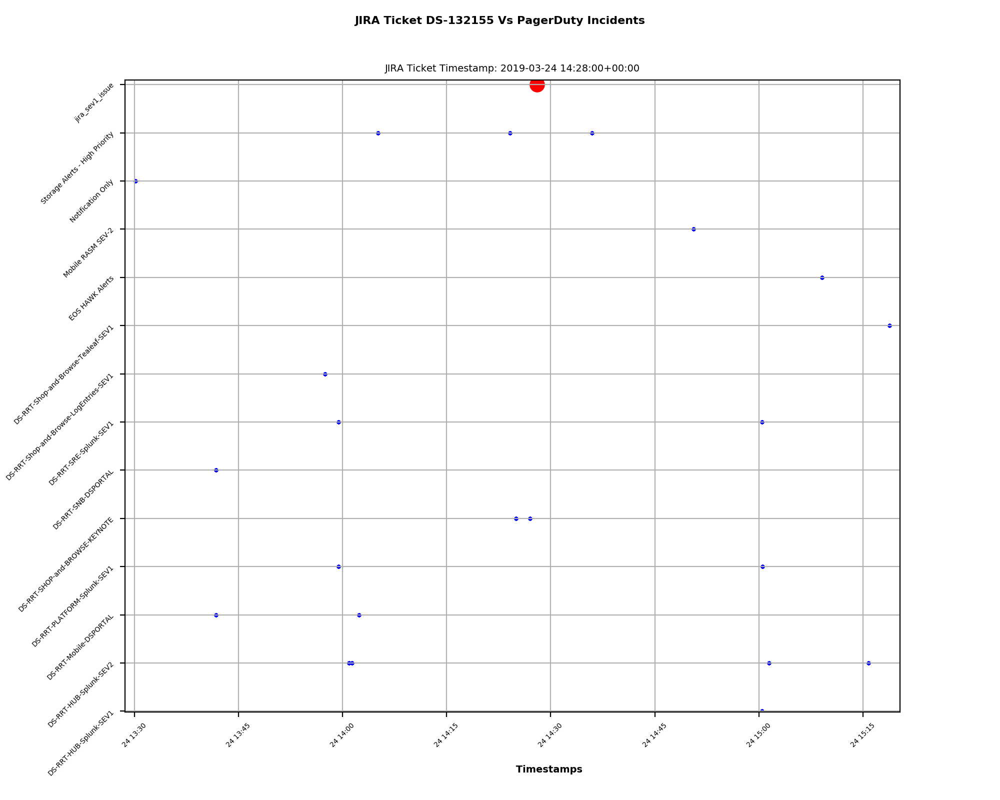

<IPython.core.display.Javascript object>


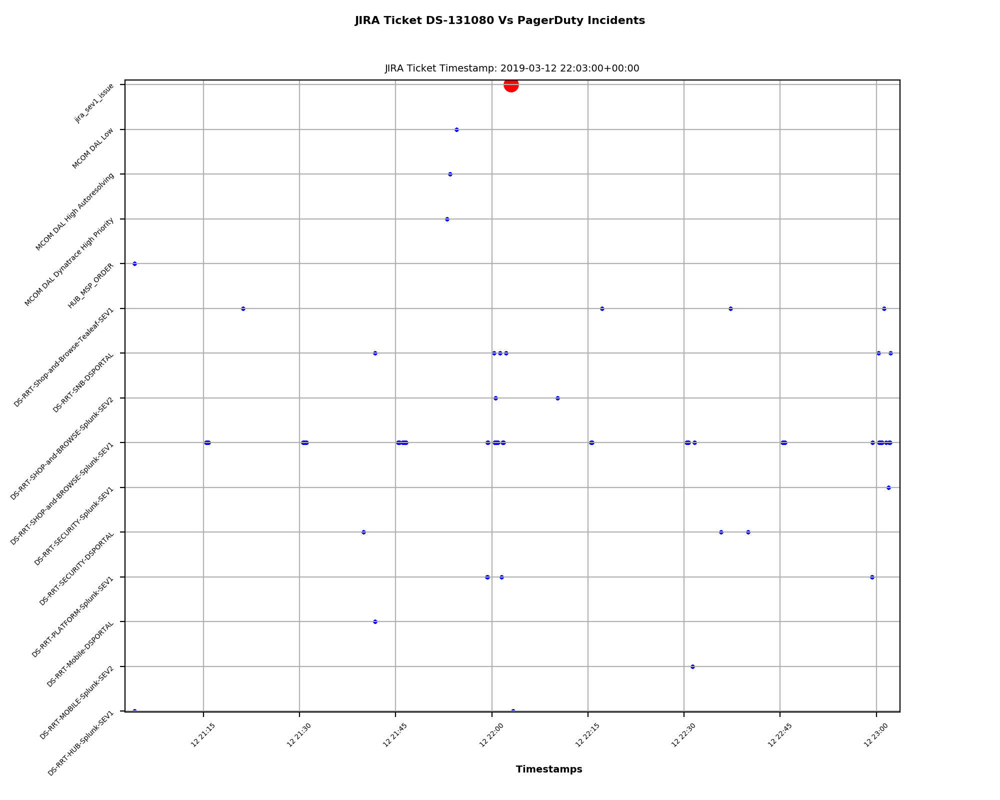

/Users/a071887/pdip/venv/lib/python3.7/site-packages/ipykernel_launcher.py:41: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


<IPython.core.display.Javascript object>


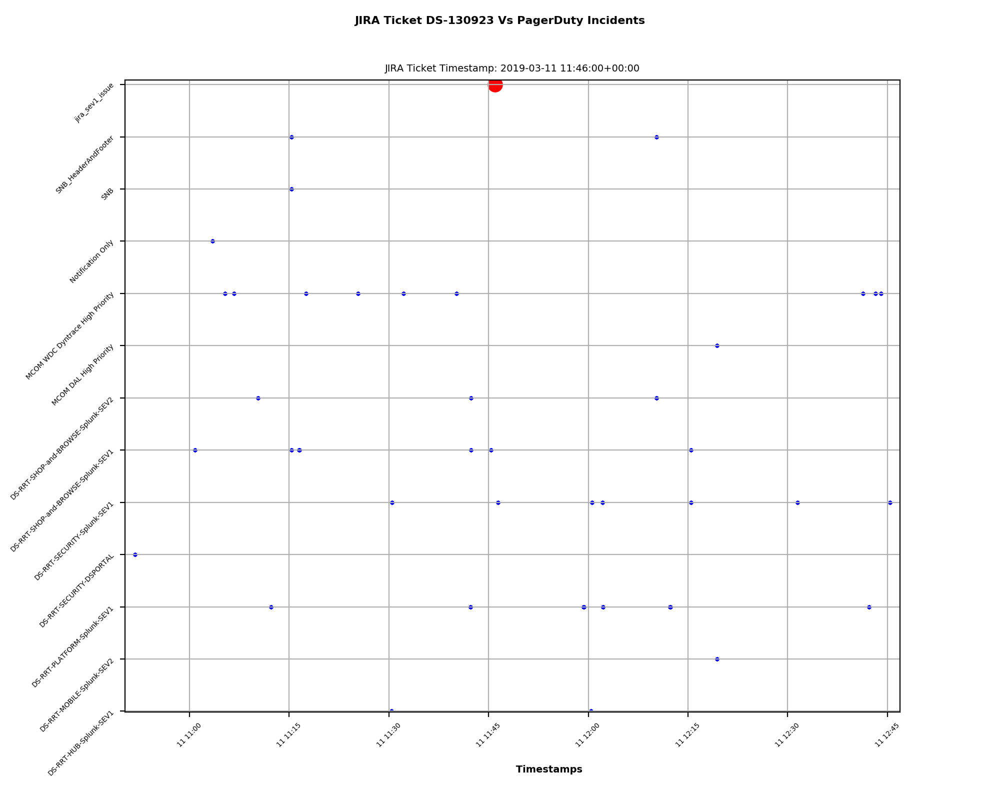

<IPython.core.display.Javascript object>


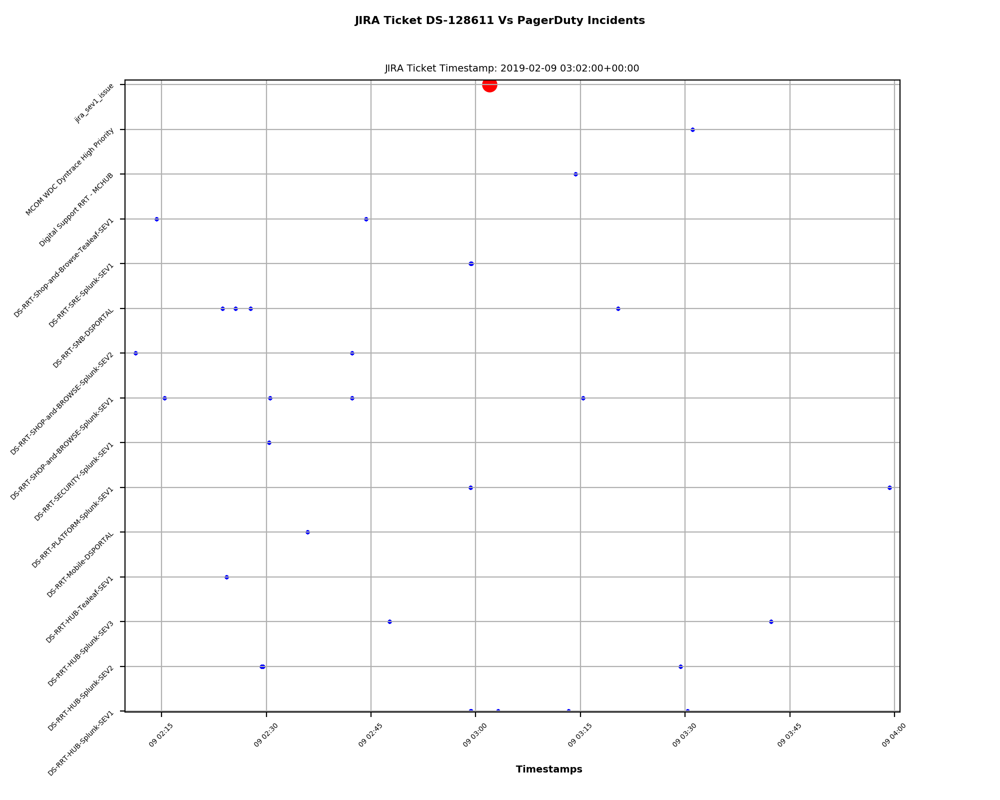

<IPython.core.display.Javascript object>


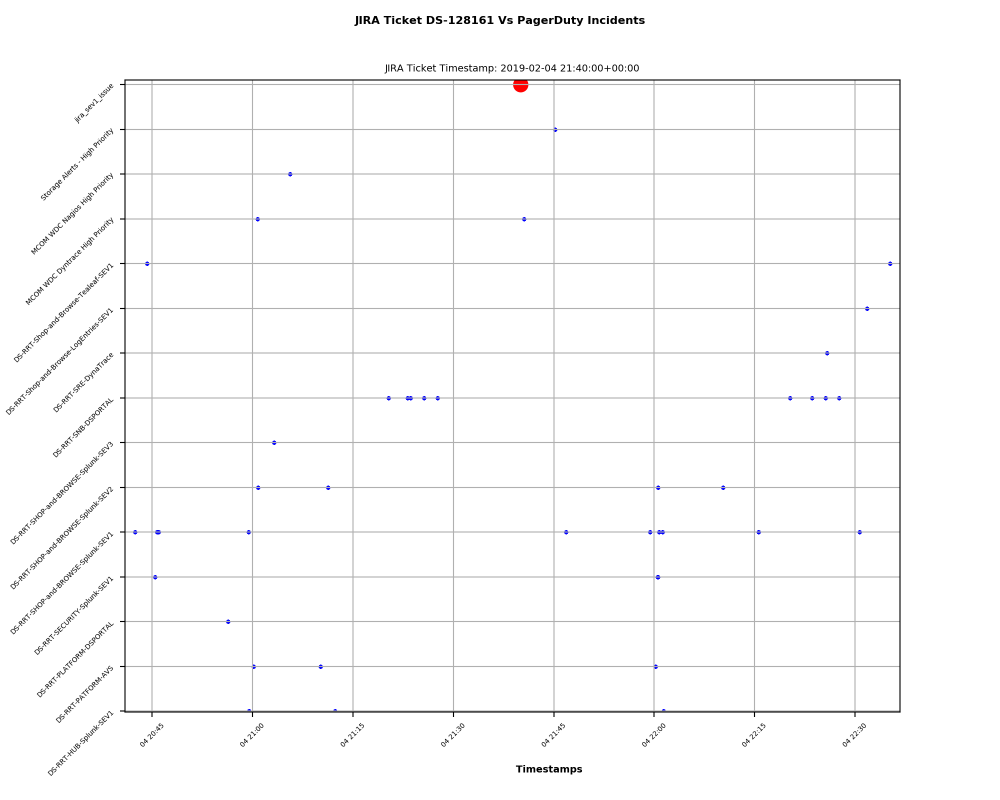

<IPython.core.display.Javascript object>


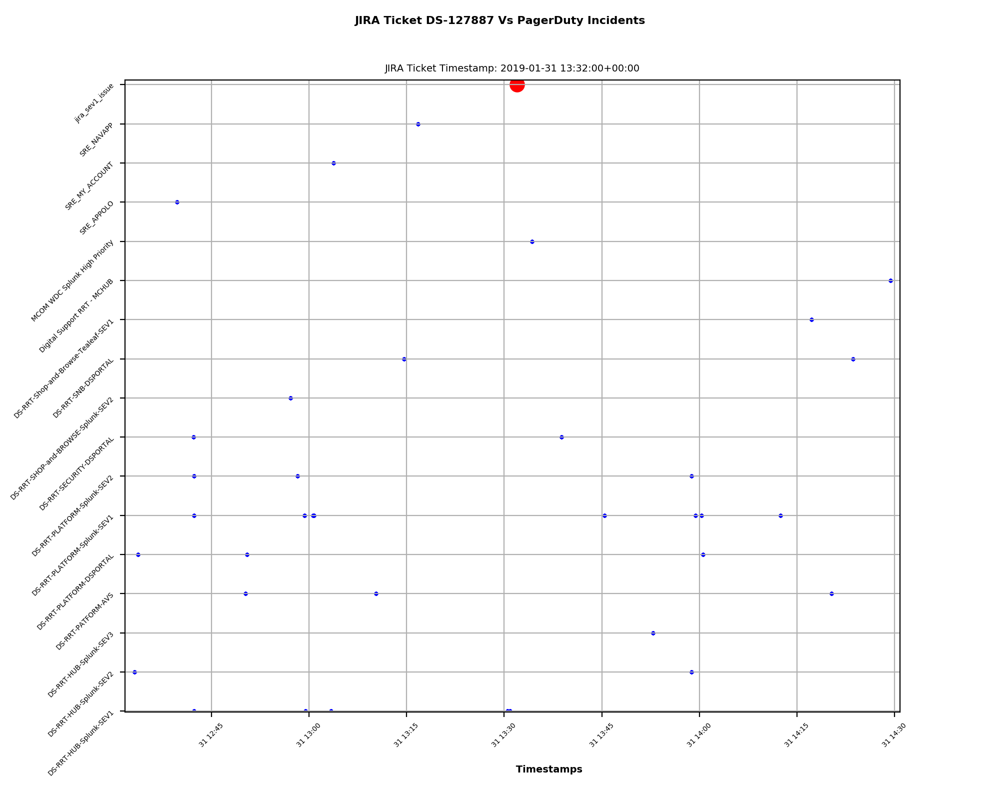

<IPython.core.display.Javascript object>


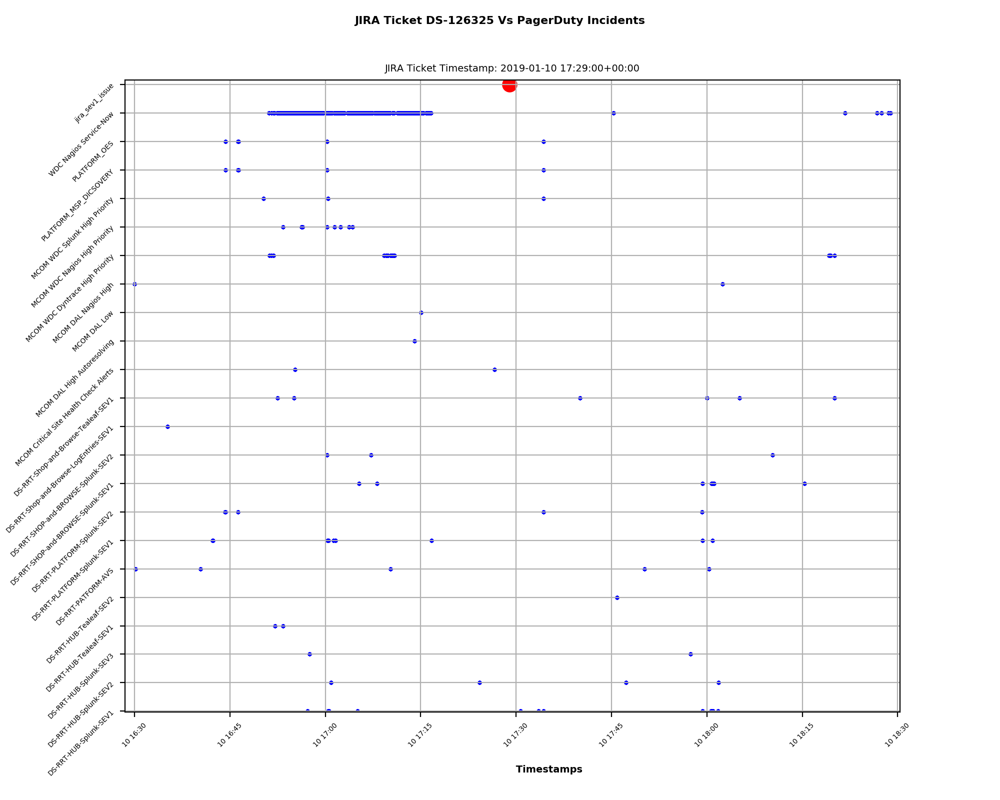

<IPython.core.display.Javascript object>


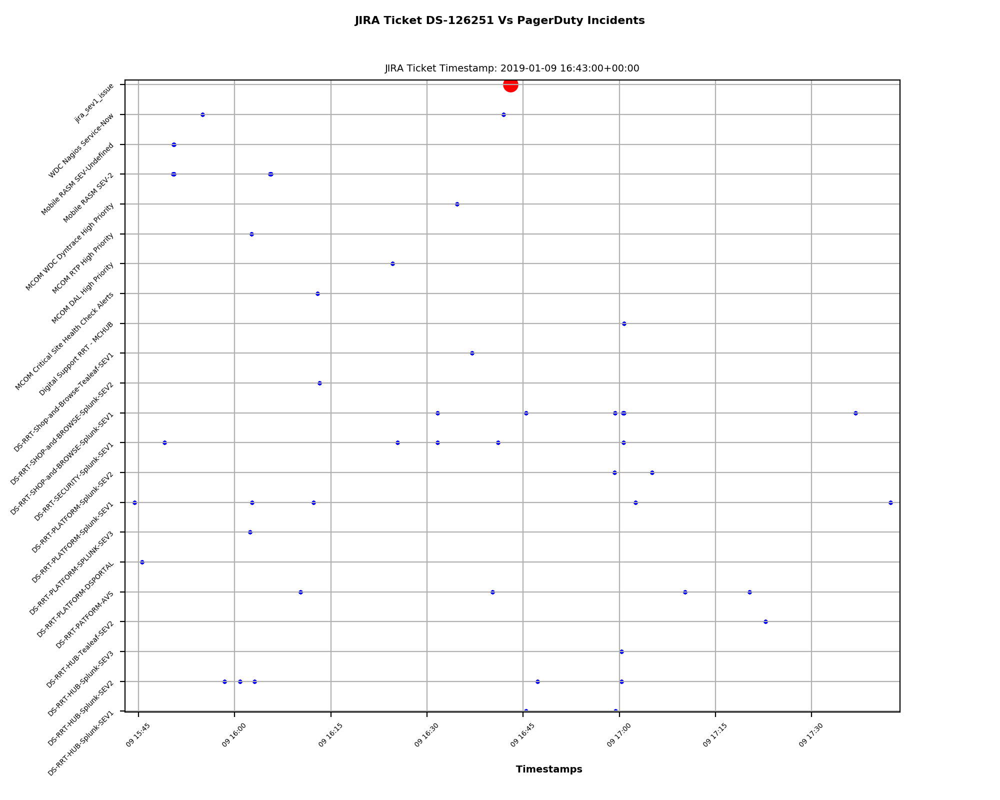

In [62]:
# function definition - which will take a list of JIRA issues, PD incidents and time frame as parameters 
#                       and generates graphs for each jira issue over the specified timeframe. 

def plot_jira_vs_incidents(jira_issues, pd_incidents, relative_time_window, output_folder):
    #jira_issues -> pre-processed pandas dataframe at least with columns "created_datetime" and "service_name"
                #"created_datetime" -> jira issue created timestamp
    #pd_incidents -> pre-processed pandas dataframe at least with columns "created_datetime", "service_name", "service_name", "description", 
                #relative_time_window -> integer value, this value will be used to decide how many units of time to go 
                #before and after of an JIRA issue's timestamp to look for pd incidents
    #output_folder -> to save generated charts
    
    import pandasql as ps
    import numpy as np

    jira_issues['created_datetime_plus'] = jira_issues.created_datetime + pd.DateOffset(hours=relative_time_window)
    jira_issues['created_datetime_minus'] = jira_issues.created_datetime - pd.DateOffset(hours=relative_time_window)
    
    sqlcode = '''
    select  pd_incidents.service_name pd_service_name, 
            pd_incidents.description pd_description,
            pd_incidents.created_datetime pd_created_datetime,
            jira_issues.created_datetime jira_created_datetime,
            jira_issues.service_name jira_service_name,
            jira_issues.jira_ticket jira_ticket
    from jira_issues
    left outer join pd_incidents on pd_incidents.created_datetime >= jira_issues.created_datetime_minus 
    and pd_incidents.created_datetime <= jira_issues.created_datetime_plus
    '''
    combined = ps.sqldf(sqlcode,locals())
    combined = combined.mask(combined.eq('None')).dropna()
    combined['pd_created_datetime'] = [pd.to_datetime(d,utc=True) for d in combined['pd_created_datetime']]
    combined['jira_created_datetime'] = [pd.to_datetime(d,utc=True) for d in combined['jira_created_datetime']]
    
    figs = []
    axs = []
    i=0
    jiraissuetimestamps = combined['jira_created_datetime'].unique()
    #jiraissuetimestamps = ['2019-01-10 17:29:00+00:00','2019-02-09 03:02:00+00:00']
    #for jiraissuetimestamp in combined['jira_created_datetime']:
    for jiraissuetimestamp in jiraissuetimestamps:
        fig, ax = plt.subplots()
        figs.append(fig)
        axs.append(ax)
        figs[i].set_figheight(8)
        figs[i].set_figwidth(10)
        figs[i].subplots_adjust(top=0.90)
        #print(jiraissuetimestamp)
        mask = (combined['jira_created_datetime'] == jiraissuetimestamp)
        combined_filtered = combined.loc[mask]
        jiraticket = combined_filtered.jira_ticket.unique()
        figs[i].suptitle('JIRA Ticket ' + str(jiraticket[0]) + ' Vs PagerDuty Incidents', fontweight='bold', fontsize=8)
        jira_grouped = combined_filtered.groupby(['jira_created_datetime','jira_service_name']).count()['pd_description'].reset_index()
        pd_incidents_grouped = combined_filtered.groupby(['pd_created_datetime','pd_service_name']).count()['pd_description'].reset_index().sort_values('pd_service_name', ascending=True)
        jira_plus_pd_grouped = pd_incidents_grouped.append(jira_grouped)

        jiraservicenamelist = jira_grouped.jira_service_name.unique()
        pdservicenamelist = pd_incidents_grouped.pd_service_name.unique()

        for servicename in pdservicenamelist:
            color = 'blue'
            scale = 3
            axs[i].margins(x=-0.001, y=0)
            axs[i].scatter(pd_incidents_grouped['pd_created_datetime'],pd_incidents_grouped['pd_service_name'],c=color,s=scale)
        for servicename in jiraservicenamelist:
            color = 'red'
            scale = 100
            axs[i].margins(x=-0.001, y=0)
            axs[i].scatter(jira_grouped['jira_created_datetime'],jira_grouped['jira_service_name'],c=color,s=scale)
        axs[i].set_title('JIRA Ticket Timestamp: ' + str(jiraissuetimestamp),fontsize=7)    
        axs[i].grid(True)  
        for tick in axs[i].xaxis.get_major_ticks():
                tick.label.set_fontsize(5)  
                tick.label.set_rotation('45')
        for tick in axs[i].yaxis.get_major_ticks():
                tick.label.set_fontsize(5)  
                tick.label.set_rotation('45')

        axs[i].set_ylabel('PagerDuty Service Names \n',horizontalalignment='left', fontweight='bold', fontsize=7)
        axs[i].set_xlabel('\n Timestamps',horizontalalignment='left', fontweight='bold', fontsize=7)
        axs[i].set_xlabel('\n Timestamps',horizontalalignment='left', fontweight='bold', fontsize=7)
        plt.savefig(output_directory + 'JIRA_Ticket_' + str(jiraticket[0]) + '.png')
        i=i+1
        
# call the function by passing pre-processed dataframes
plot_jira_vs_incidents(jira_otb,filtered_incidents, 1,output_directory)